In [ ]:
#@title Try it yourself ---> Install Libraries & Pretrained models
print ("Installing Libraries...")
import os; os.system('pip install --upgrade --no-cache-dir gdown tensorfn')
os.system('pip install --upgrade --no-cache-dir pydantic==1.10.14')
print ("---> Successfully Installed.")
print ("Downloading PIDM models...")
os.system('git clone https://github.com/ankanbhunia/PIDM')
os.system('gdown 1WkV5Pn-_fBdiZlvVHHx_S97YESBkx4lD && mkdir PIDM/checkpoints && mv last.pt PIDM/checkpoints/last.pt')
print ("---> Successfully Downloaded.")

Installing Libraries...
---> Successfully Installed.
---> Successfully Downloaded.


/content/PIDM


Saving CL1040215_DN01839-1.jpg to CL1040215_DN01839-1.jpg


50it [00:52,  1.06s/it]


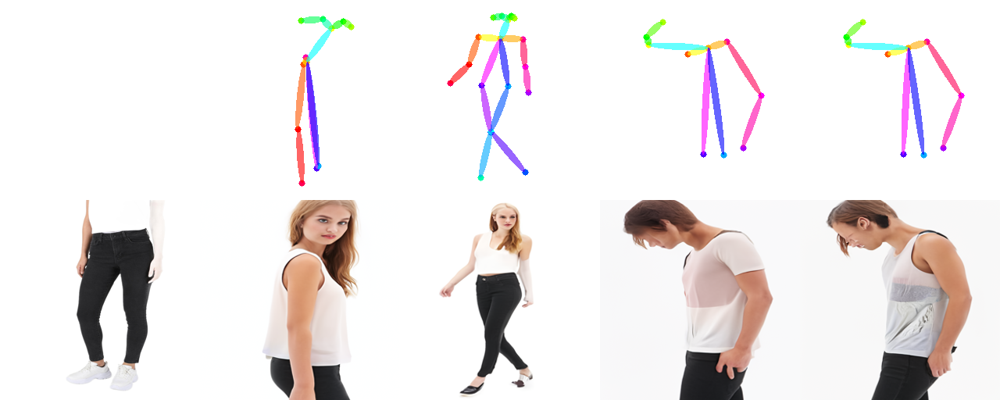

In [ ]:
#@title Pose Control using PIDM
%cd "/content/PIDM"
from predict import Predictor
from IPython.display import Image
from google.colab import files
obj = Predictor()

### upload a source file
Path = list(files.upload().keys())[0] # Please check "/content/PIDM/data/" for sample images for source file.
### OR enter the path
#Path = "data/deepfashion_256x256/target_edits/reference_img_5.png"

obj.predict_pose(image=Path, sample_algorithm='ddim', num_poses=4, nsteps=50)

Image('output.png')

In [ ]:
import pandas as pd
import requests
from PIL import Image
from io import BytesIO
import os
import base64

# Google Colab'da çalışma dizinini ayarlama
%cd "/content/PIDM"

# CSV dosyasını yükleme
csv_path = '/content/data.csv'  # CSV dosyanızın yolu
df = pd.read_csv(csv_path)

# `predict_pose` fonksiyonunu içeren `Predictor` sınıfını yükleme
from predict import Predictor
obj = Predictor()

# Çıktı dizini oluşturma
output_dir = "/content/PIDM/outputs/"
os.makedirs(output_dir, exist_ok=True)

# Her URL için işlemi gerçekleştirme
for index, row in df.iterrows():
    if index >= 20:  # İlk 20 satırı işlemek için
        break

    image_url = row['SecenekResim1']
    try:
        # URL'den resmi indirme
        response = requests.get(image_url)
        image = Image.open(BytesIO(response.content))

        # Resmi küçültme (örneğin 512x512 piksel)
        image.thumbnail((512, 512))

        # Resmi geçici olarak kaydetme
        local_path = os.path.join(output_dir, f"image_{index}.png")
        image.save(local_path)

        # `predict_pose` fonksiyonunu çağırma (num_poses=3 için)
        result_image_path = obj.predict_pose(image=local_path, sample_algorithm='ddim', num_poses=3, nsteps=50)

        if result_image_path is not None:
            # Sonuç resmini küçük hale getirme
            image = Image.open(BytesIO(response.content))
            image.thumbnail((256, 256))  # Giriş görüntüsünü küçültmek için boyutu ayarlayın
            image.save(local_path)


            # Küçük resmi base64 formatına çevirme
            buffered = BytesIO()
            result_image.save(buffered, format="PNG")
            encoded_string = base64.b64encode(buffered.getvalue()).decode('utf-8')

            # Sonucu Model Ön ve Model Arka sütunlarına ekleme
            df.at[index, 'Model Ön'] = encoded_string
            df.at[index, 'Model Arka'] = encoded_string

            # Sonuç resimlerini gösterme
            display(result_image)
        else:
            print(f"Resim {image_url} işlenirken bir hata oluştu: predict_pose fonksiyonu None döndü")

    except Exception as e:
        print(f"Resim {image_url} işlenirken bir hata oluştu: {e}")

# Güncellenmiş CSV dosyasını kaydetme
df.to_csv(csv_path, index=False)




/content/PIDM


4it [00:04,  1.17s/it]


KeyboardInterrupt: 

In [ ]:
import torch
torch.cuda.empty_cache()

In [ ]:
!wget -O /content/cloth_segm.pth  'https://huggingface.co/oyelmali/Clothes-Semantic-Segmentation/resolve/main/cloth_segm.pth'

--2024-08-14 17:02:43--  https://huggingface.co/oyelmali/Clothes-Semantic-Segmentation/resolve/main/cloth_segm.pth
Resolving huggingface.co (huggingface.co)... 18.164.174.55, 18.164.174.23, 18.164.174.118, ...
Connecting to huggingface.co (huggingface.co)|18.164.174.55|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://cdn-lfs-us-1.huggingface.co/repos/d4/05/d405d0816910f5fbb08078e1d4250ea6403a26140a5e5718ab9691266a6a6828/f71fad2bc11789a996acc507d1a5a1602ae0edefc2b9aba1cd198be5cc9c1a44?response-content-disposition=inline%3B+filename*%3DUTF-8%27%27cloth_segm.pth%3B+filename%3D%22cloth_segm.pth%22%3B&Expires=1723914163&Policy=eyJTdGF0ZW1lbnQiOlt7IkNvbmRpdGlvbiI6eyJEYXRlTGVzc1RoYW4iOnsiQVdTOkVwb2NoVGltZSI6MTcyMzkxNDE2M319LCJSZXNvdXJjZSI6Imh0dHBzOi8vY2RuLWxmcy11cy0xLmh1Z2dpbmdmYWNlLmNvL3JlcG9zL2Q0LzA1L2Q0MDVkMDgxNjkxMGY1ZmJiMDgwNzhlMWQ0MjUwZWE2NDAzYTI2MTQwYTVlNTcxOGFiOTY5MTI2NmE2YTY4MjgvZjcxZmFkMmJjMTE3ODlhOTk2YWNjNTA3ZDFhNWExNjAyYWUwZWRlZmMyYjlhYmExY2Qx

40it [00:37,  1.05it/s]


cp: target 'Notebooks/images/pose_0_1.png' is not a directory
Resim 0 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_0_1.png


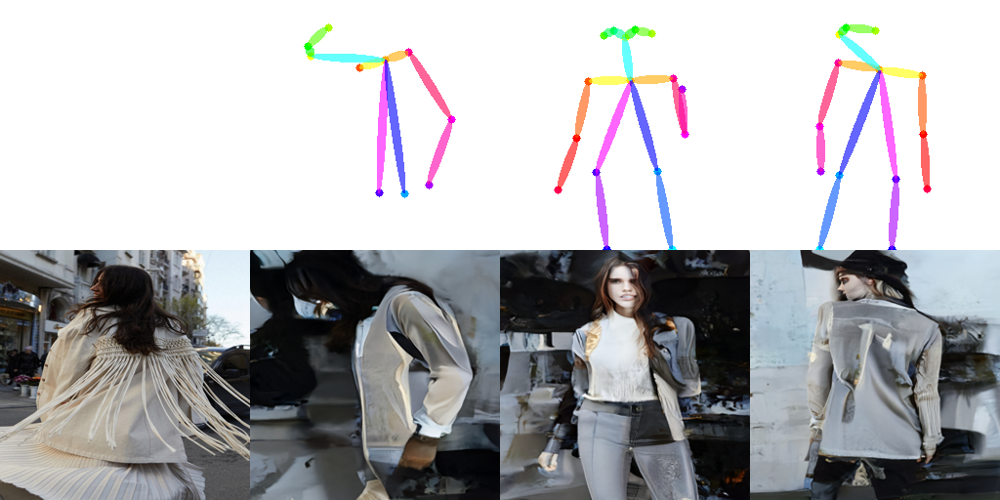

40it [00:36,  1.09it/s]


cp: target 'Notebooks/images/pose_0_2.png' is not a directory
Resim 0 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_0_2.png


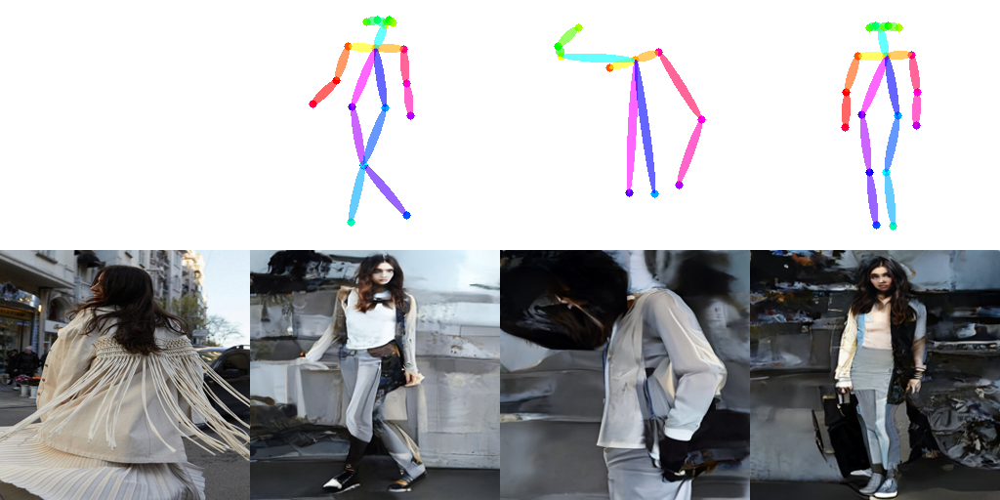

40it [00:37,  1.08it/s]


cp: target 'Notebooks/images/pose_0_3.png' is not a directory
Resim 0 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_0_3.png


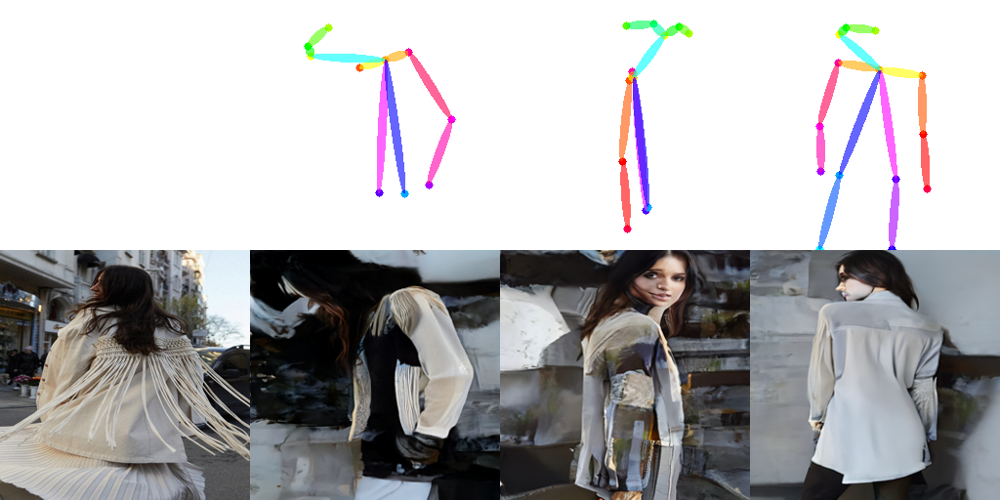

40it [00:36,  1.09it/s]


cp: target 'Notebooks/images/pose_0_4.png' is not a directory
Resim 0 için Pose 4 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_0_4.png


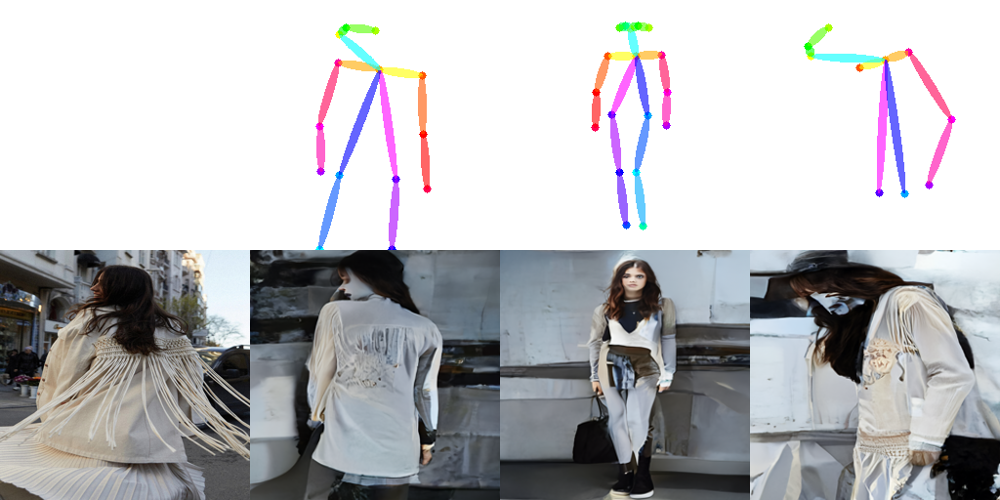

40it [00:37,  1.08it/s]


cp: target 'Notebooks/images/pose_1_1.png' is not a directory
Resim 1 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_1_1.png


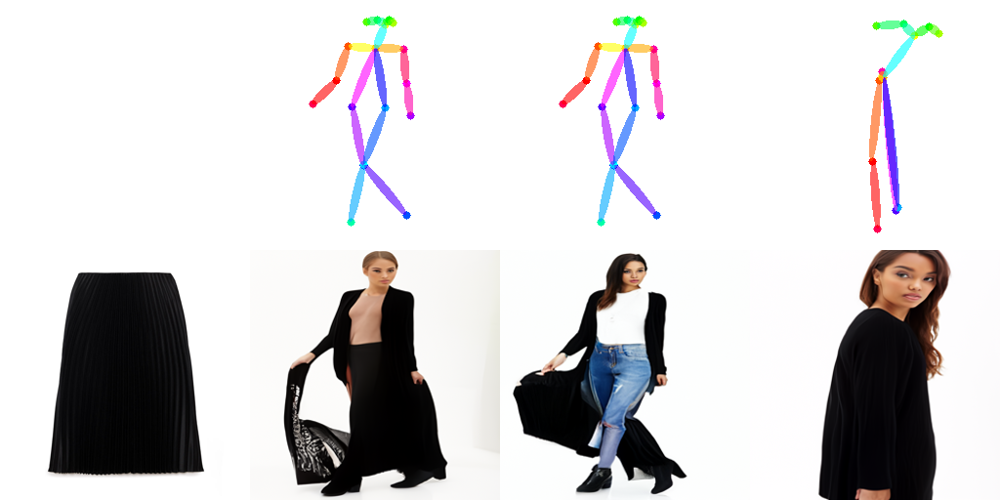

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_1_2.png' is not a directory
Resim 1 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_1_2.png


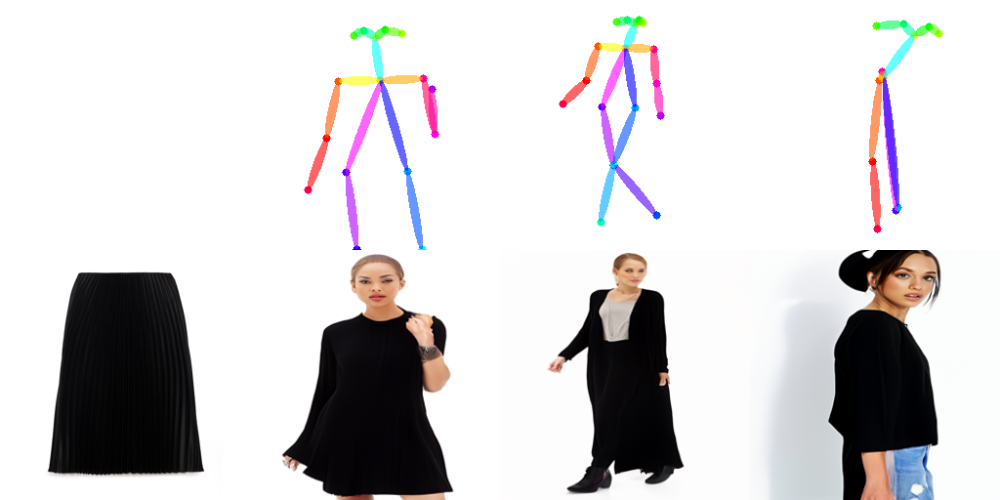

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_1_3.png' is not a directory
Resim 1 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_1_3.png


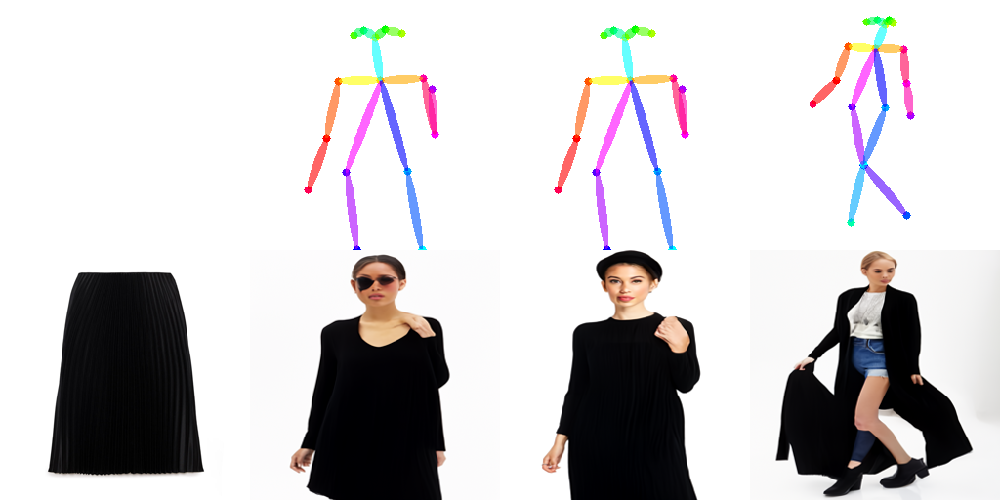

40it [00:36,  1.09it/s]


cp: target 'Notebooks/images/pose_1_4.png' is not a directory
Resim 1 için Pose 4 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_1_4.png


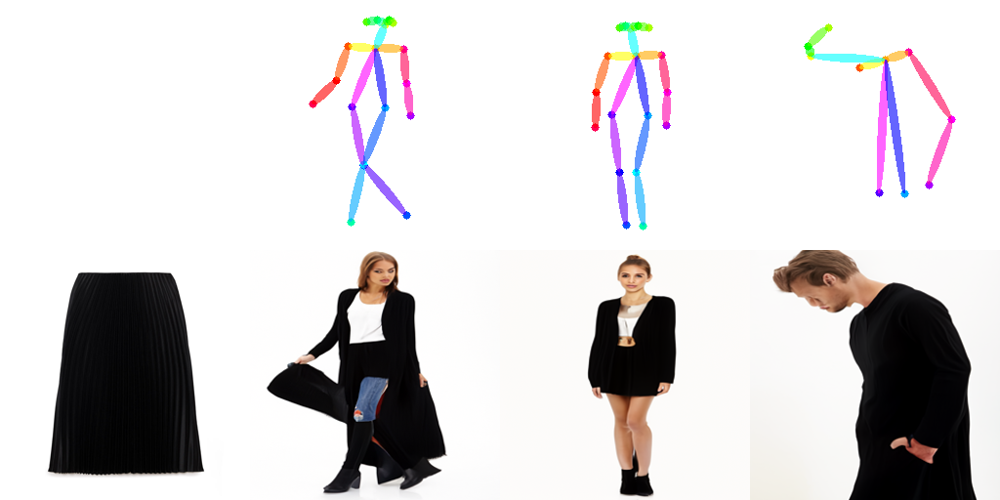

40it [00:36,  1.09it/s]


cp: target 'Notebooks/images/pose_2_1.png' is not a directory
Resim 2 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_2_1.png


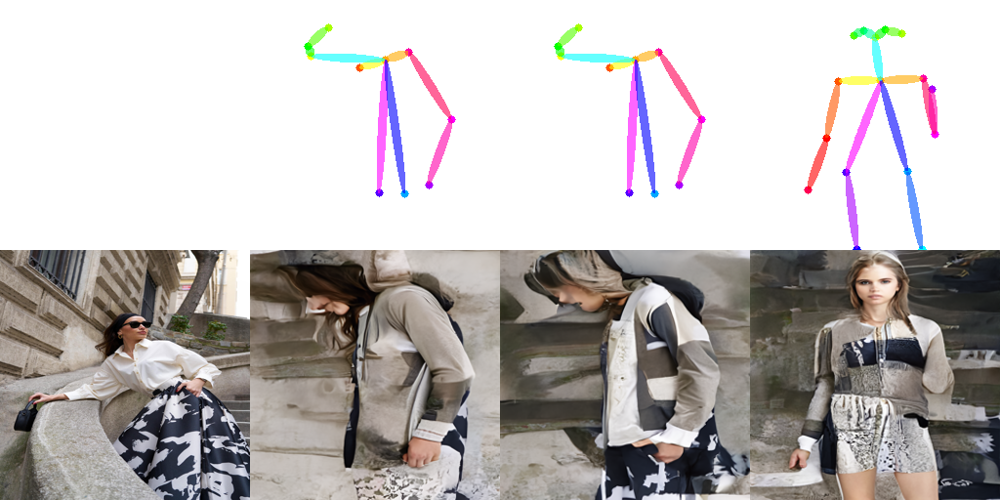

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_2_2.png' is not a directory
Resim 2 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_2_2.png


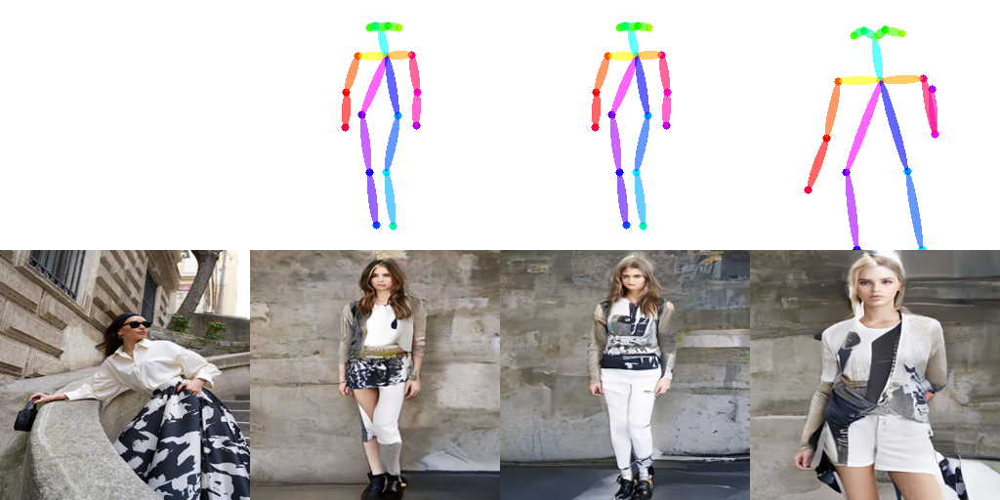

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_2_3.png' is not a directory
Resim 2 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_2_3.png


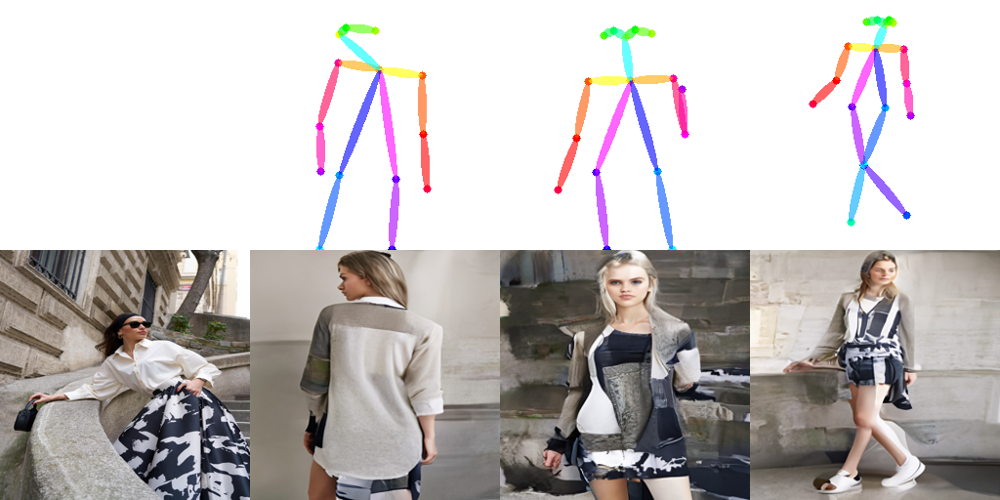

40it [00:37,  1.08it/s]


cp: target 'Notebooks/images/pose_2_4.png' is not a directory
Resim 2 için Pose 4 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_2_4.png


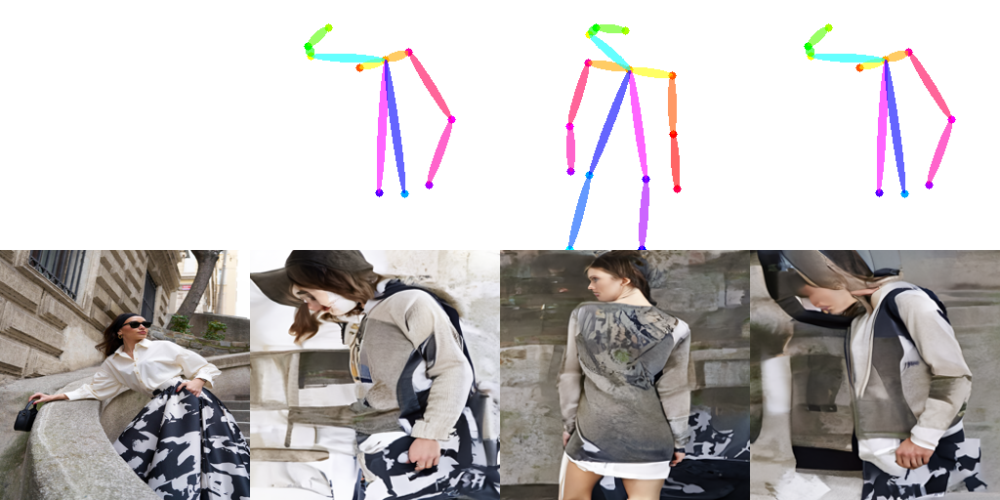

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_3_1.png' is not a directory
Resim 3 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_3_1.png


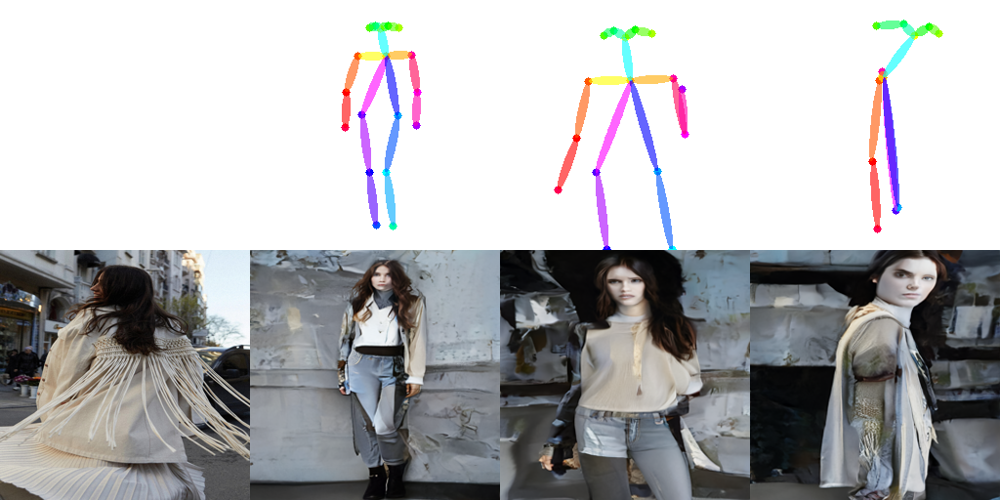

40it [00:37,  1.08it/s]


cp: target 'Notebooks/images/pose_3_2.png' is not a directory
Resim 3 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_3_2.png


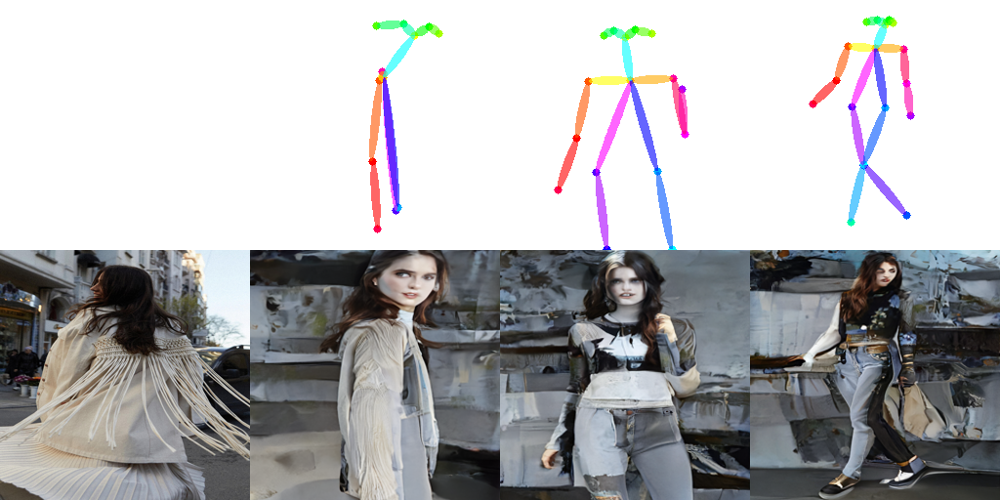

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_3_3.png' is not a directory
Resim 3 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_3_3.png


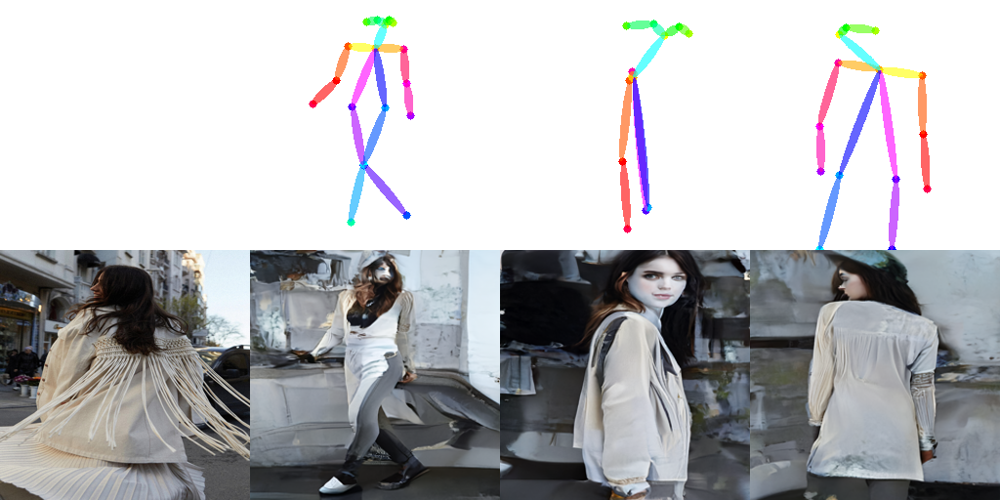

40it [00:37,  1.08it/s]


cp: target 'Notebooks/images/pose_3_4.png' is not a directory
Resim 3 için Pose 4 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_3_4.png


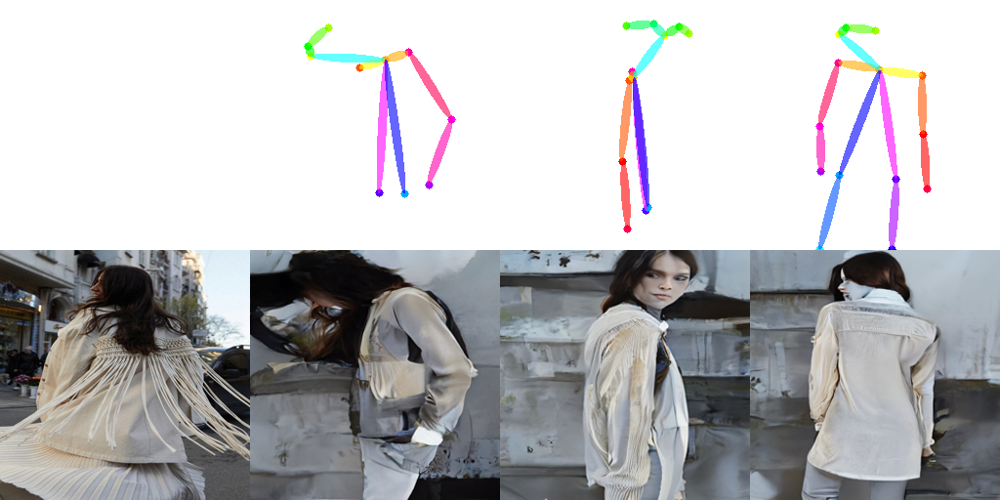

40it [00:37,  1.08it/s]


cp: target 'Notebooks/images/pose_4_1.png' is not a directory
Resim 4 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_4_1.png


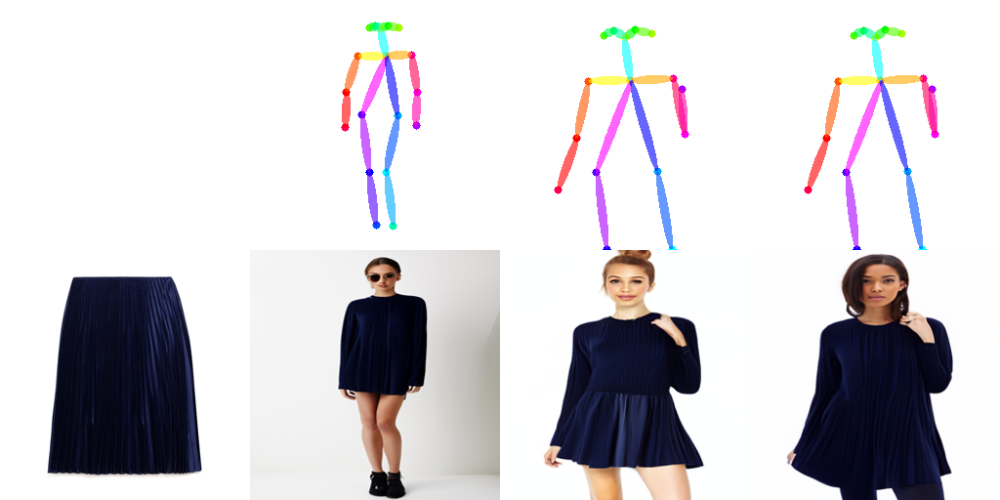

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_4_2.png' is not a directory
Resim 4 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_4_2.png


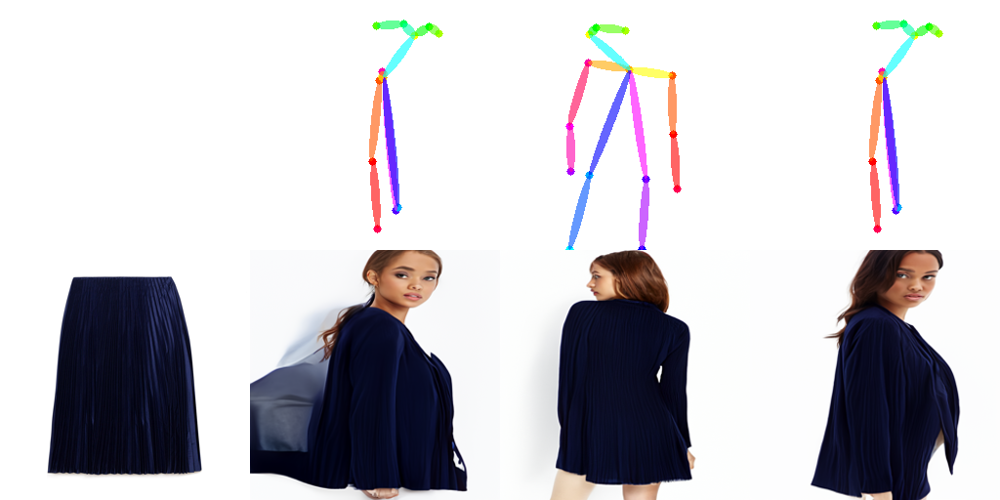

40it [00:36,  1.09it/s]


cp: target 'Notebooks/images/pose_4_3.png' is not a directory
Resim 4 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_4_3.png


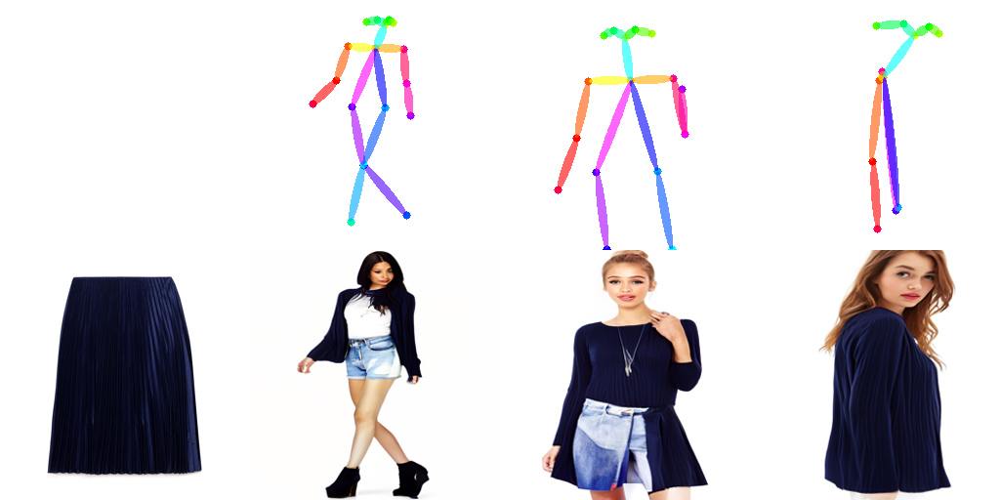

40it [00:36,  1.09it/s]


cp: target 'Notebooks/images/pose_4_4.png' is not a directory
Resim 4 için Pose 4 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_4_4.png


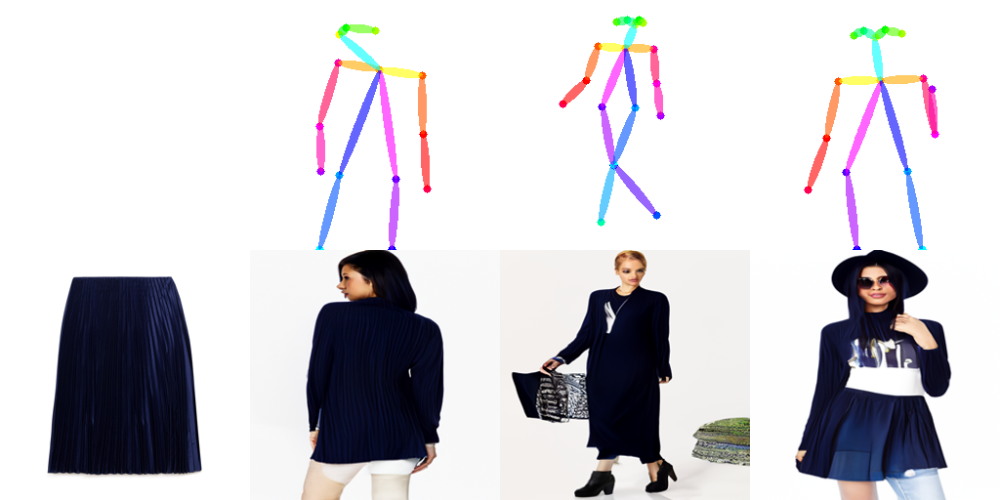

40it [00:36,  1.09it/s]


cp: target 'Notebooks/images/pose_5_1.png' is not a directory
Resim 5 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_5_1.png


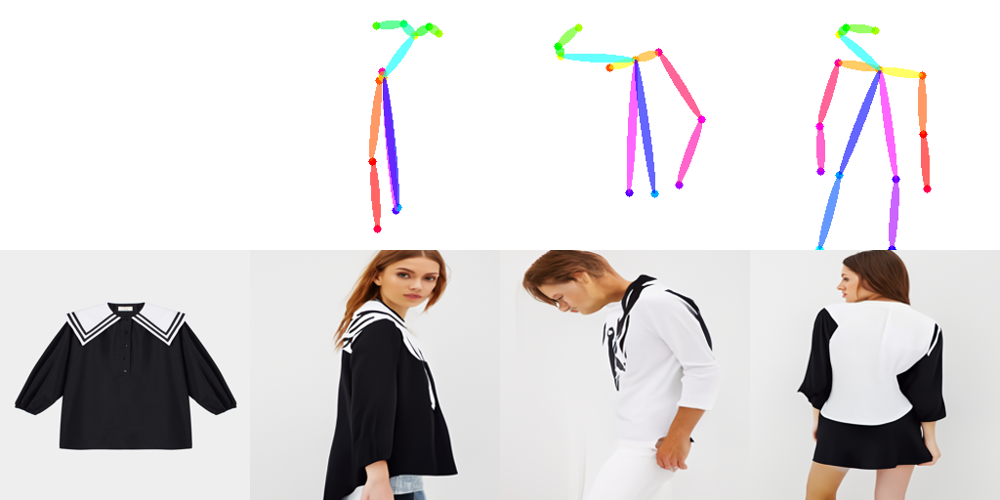

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_5_2.png' is not a directory
Resim 5 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_5_2.png


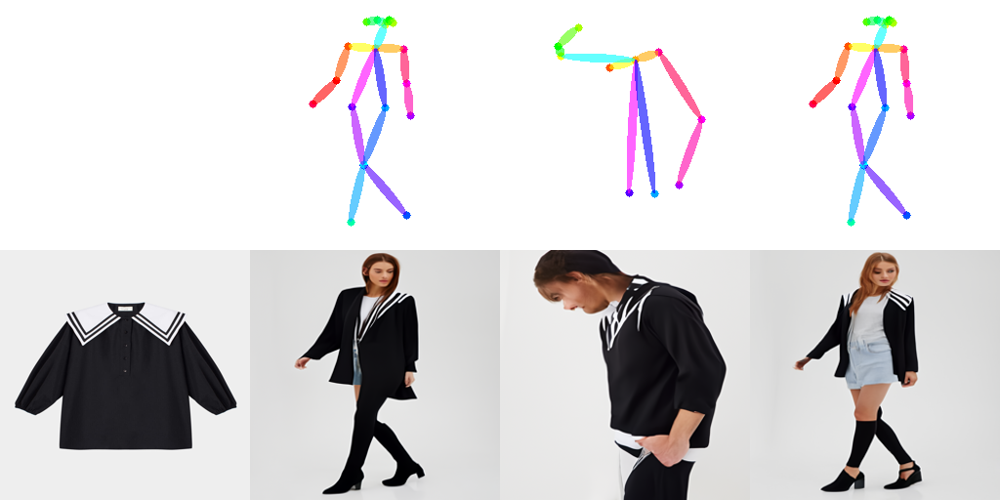

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_5_3.png' is not a directory
Resim 5 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_5_3.png


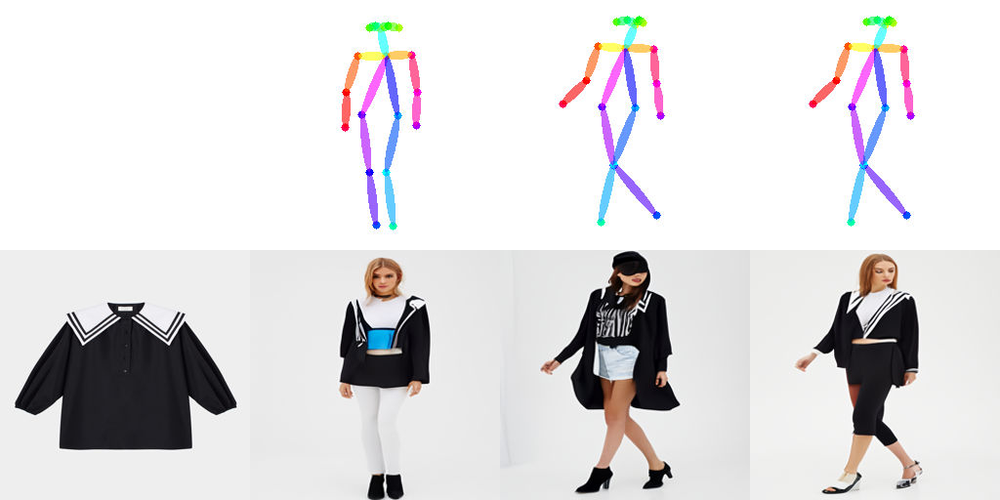

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_5_4.png' is not a directory
Resim 5 için Pose 4 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_5_4.png


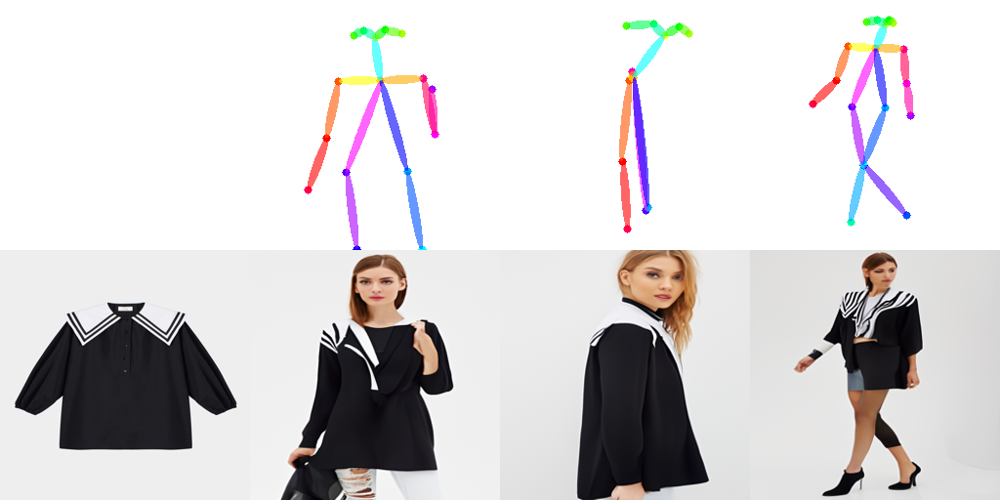

40it [00:37,  1.08it/s]


cp: target 'Notebooks/images/pose_6_1.png' is not a directory
Resim 6 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_6_1.png


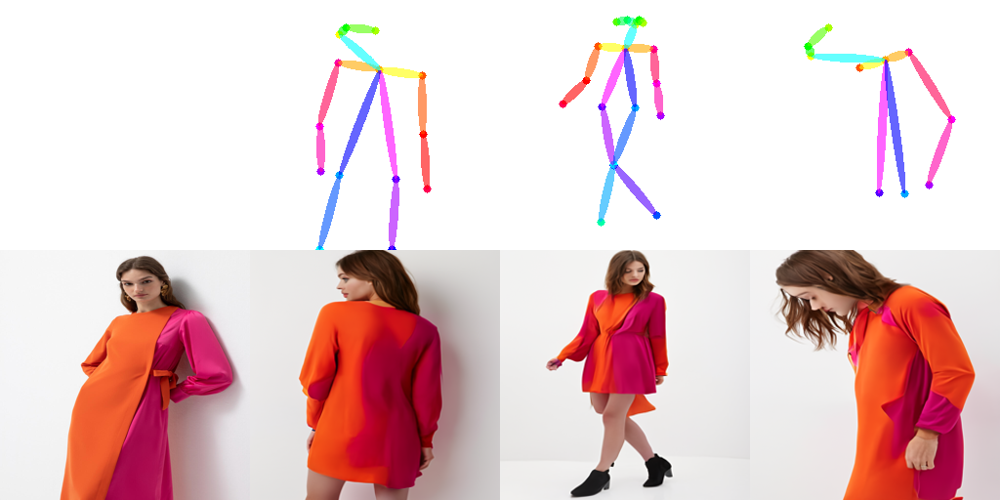

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_6_2.png' is not a directory
Resim 6 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_6_2.png


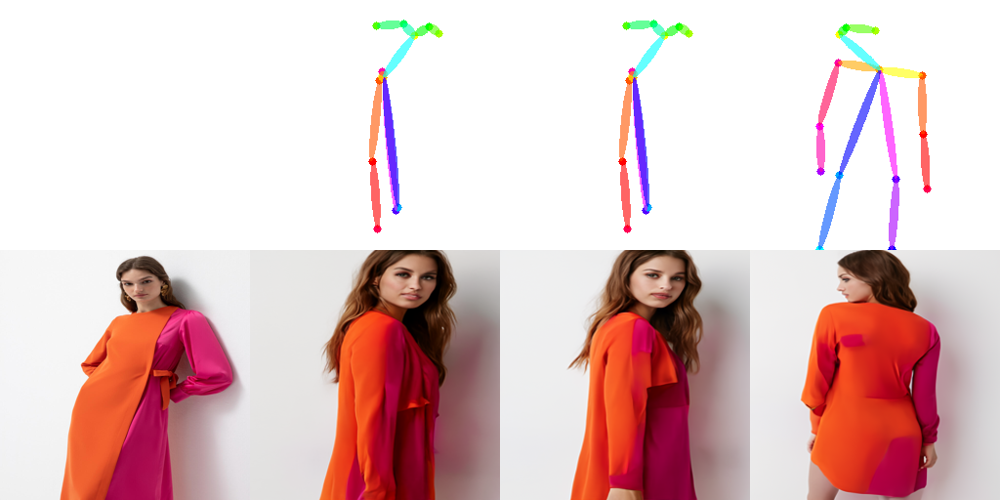

40it [00:36,  1.09it/s]


cp: target 'Notebooks/images/pose_6_3.png' is not a directory
Resim 6 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_6_3.png


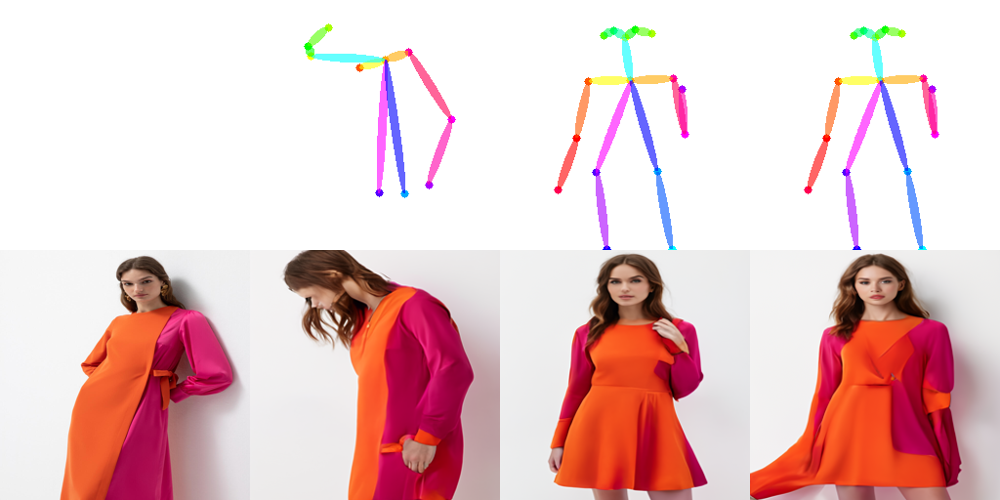

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_6_4.png' is not a directory
Resim 6 için Pose 4 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_6_4.png


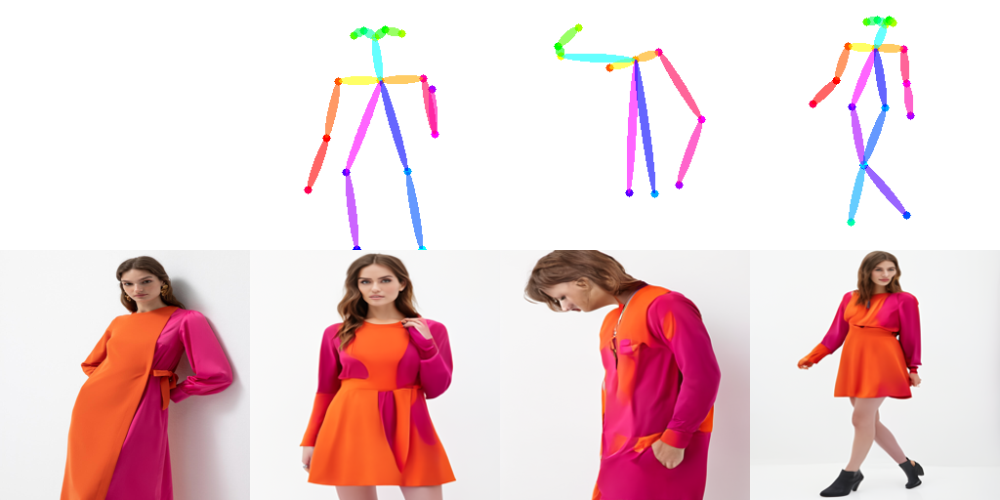

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_7_1.png' is not a directory
Resim 7 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_7_1.png


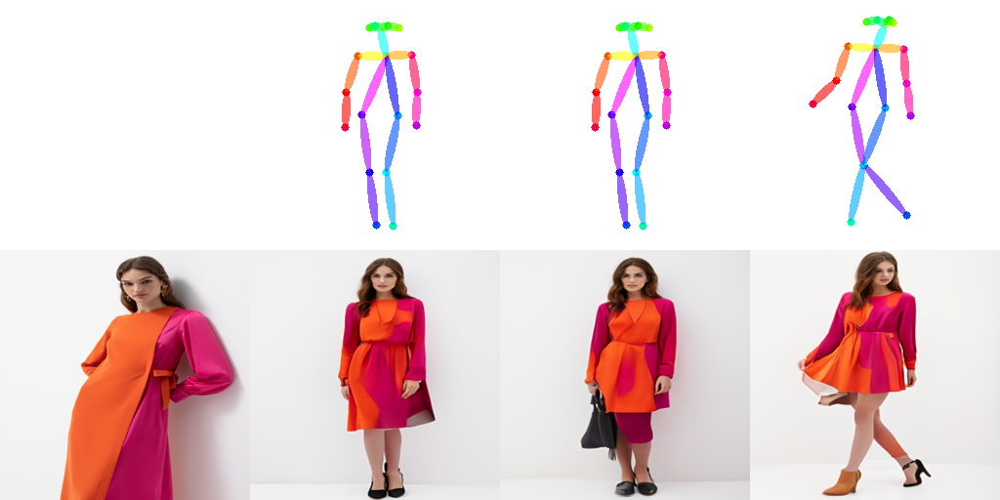

40it [00:37,  1.08it/s]


cp: target 'Notebooks/images/pose_7_2.png' is not a directory
Resim 7 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_7_2.png


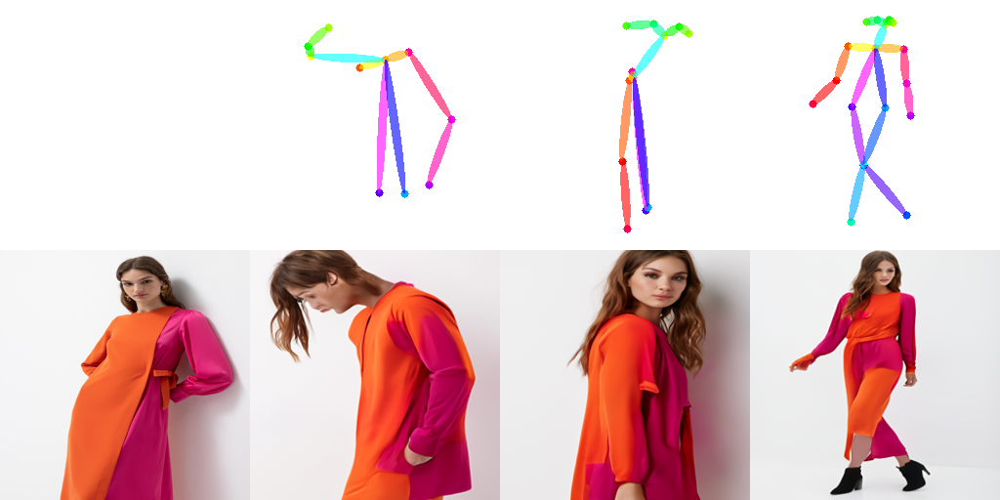

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_7_3.png' is not a directory
Resim 7 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_7_3.png


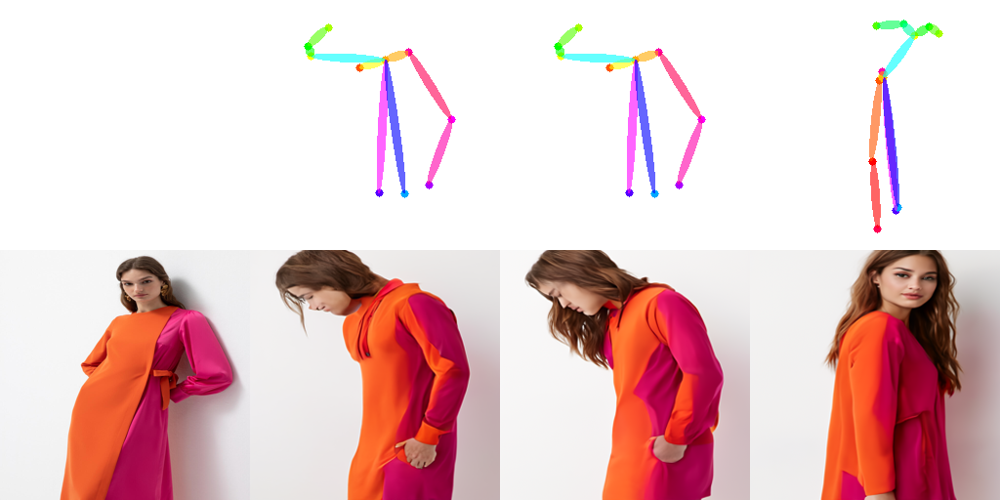

40it [00:36,  1.09it/s]


cp: target 'Notebooks/images/pose_7_4.png' is not a directory
Resim 7 için Pose 4 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_7_4.png


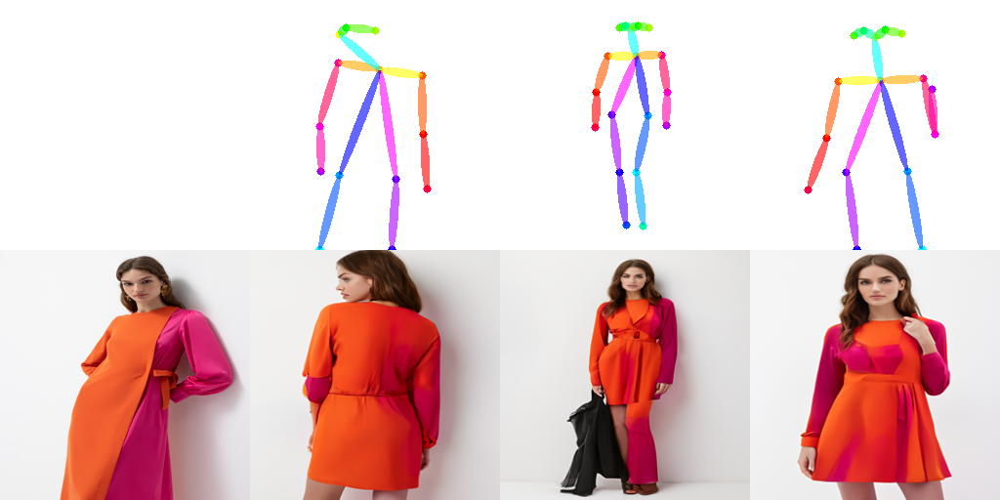

40it [00:37,  1.08it/s]


cp: target 'Notebooks/images/pose_8_1.png' is not a directory
Resim 8 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_8_1.png


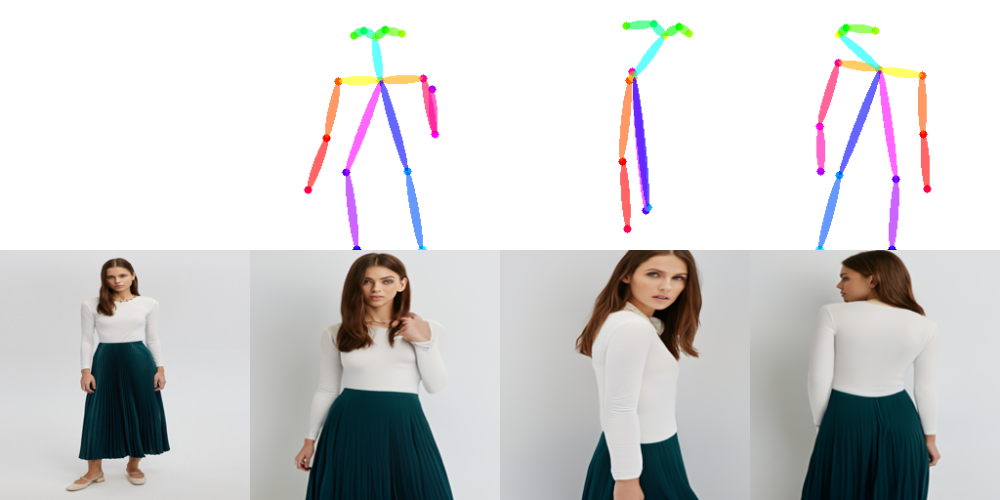

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_8_2.png' is not a directory
Resim 8 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_8_2.png


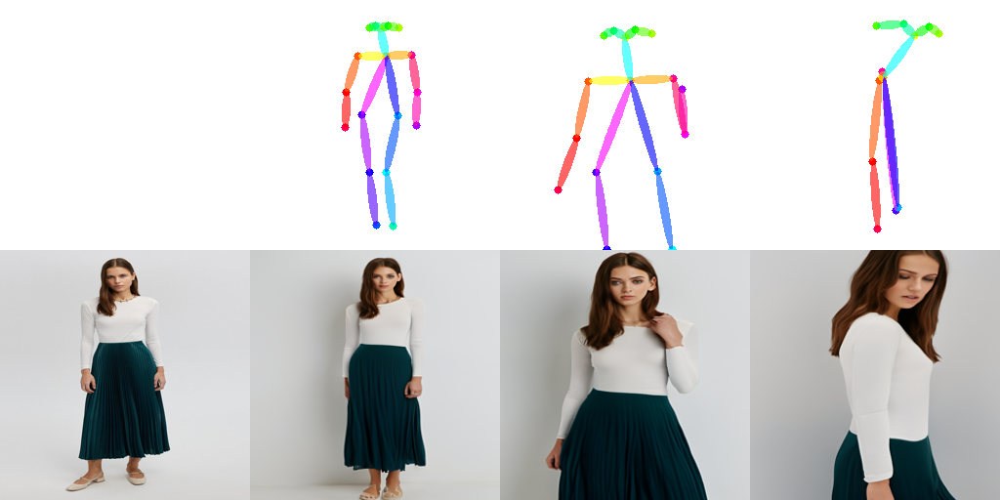

40it [00:37,  1.08it/s]


cp: target 'Notebooks/images/pose_8_3.png' is not a directory
Resim 8 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_8_3.png


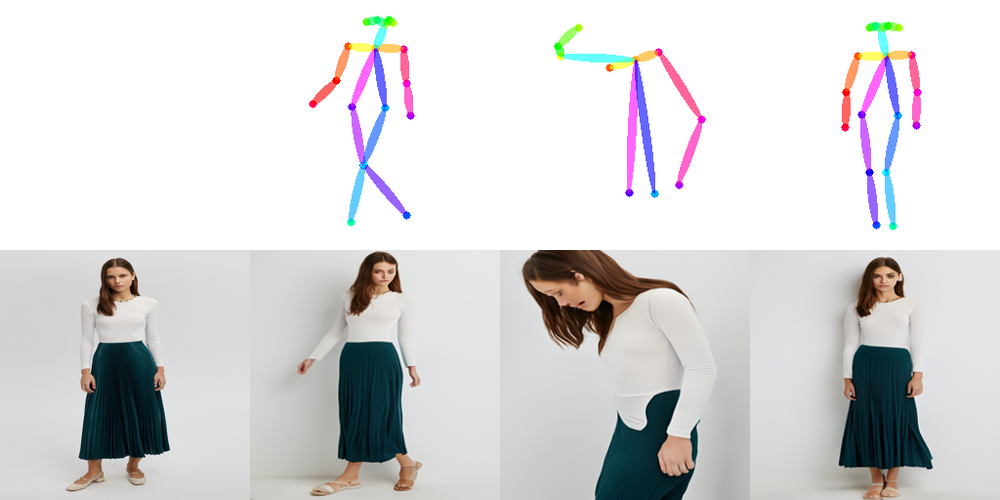

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_8_4.png' is not a directory
Resim 8 için Pose 4 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_8_4.png


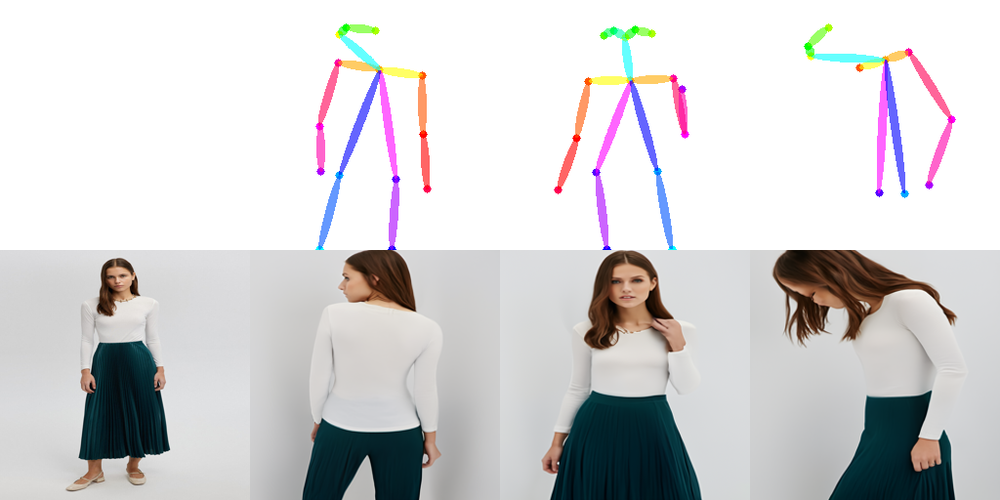

40it [00:37,  1.08it/s]


cp: target 'Notebooks/images/pose_9_1.png' is not a directory
Resim 9 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_9_1.png


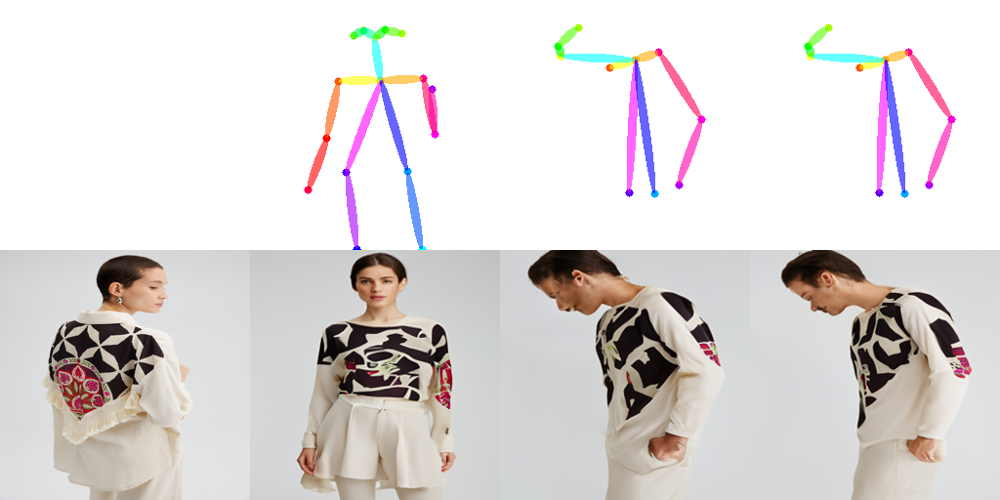

40it [00:36,  1.09it/s]


cp: target 'Notebooks/images/pose_9_2.png' is not a directory
Resim 9 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_9_2.png


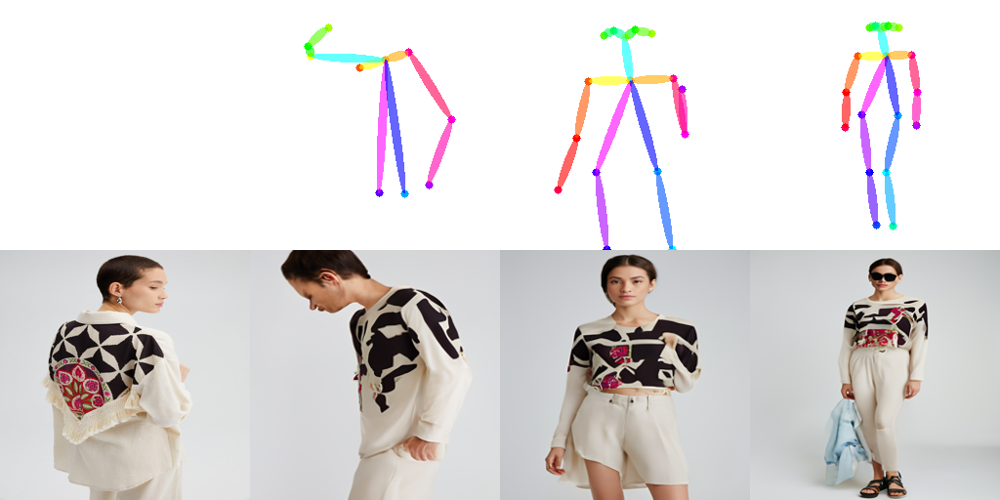

40it [00:36,  1.09it/s]


cp: target 'Notebooks/images/pose_9_3.png' is not a directory
Resim 9 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_9_3.png


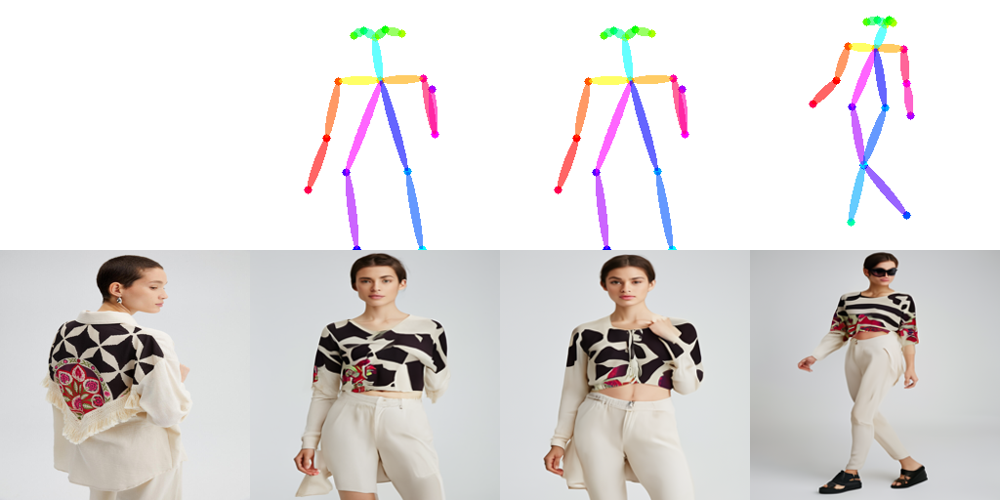

40it [00:37,  1.08it/s]


cp: target 'Notebooks/images/pose_9_4.png' is not a directory
Resim 9 için Pose 4 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_9_4.png


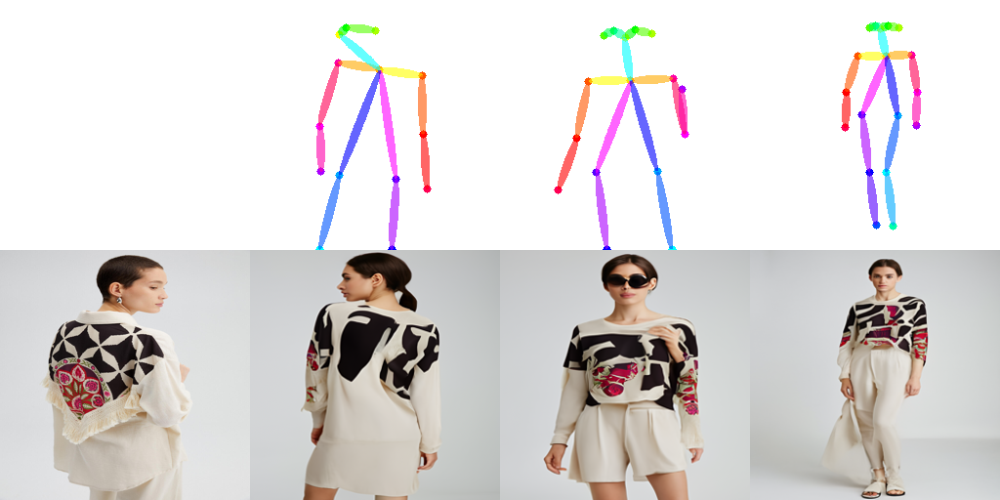

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_10_1.png' is not a directory
Resim 10 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_10_1.png


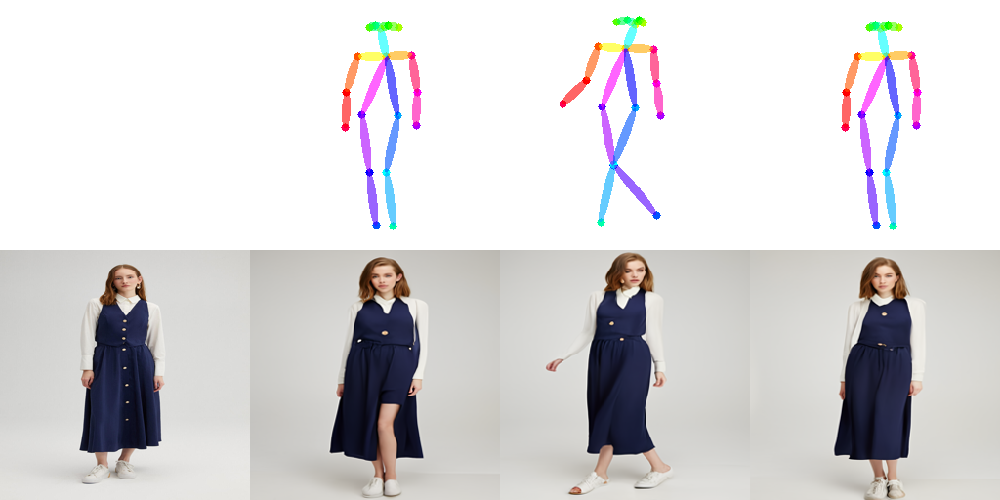

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_10_2.png' is not a directory
Resim 10 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_10_2.png


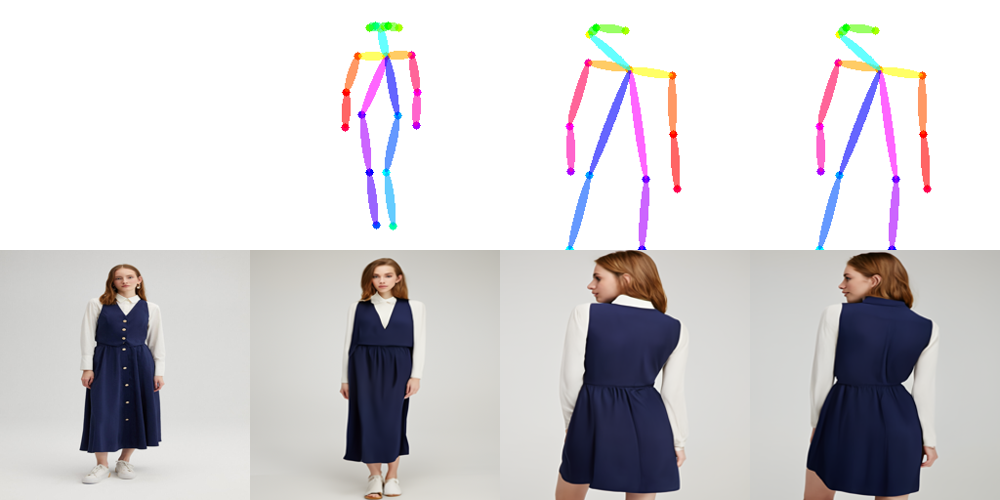

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_10_3.png' is not a directory
Resim 10 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_10_3.png


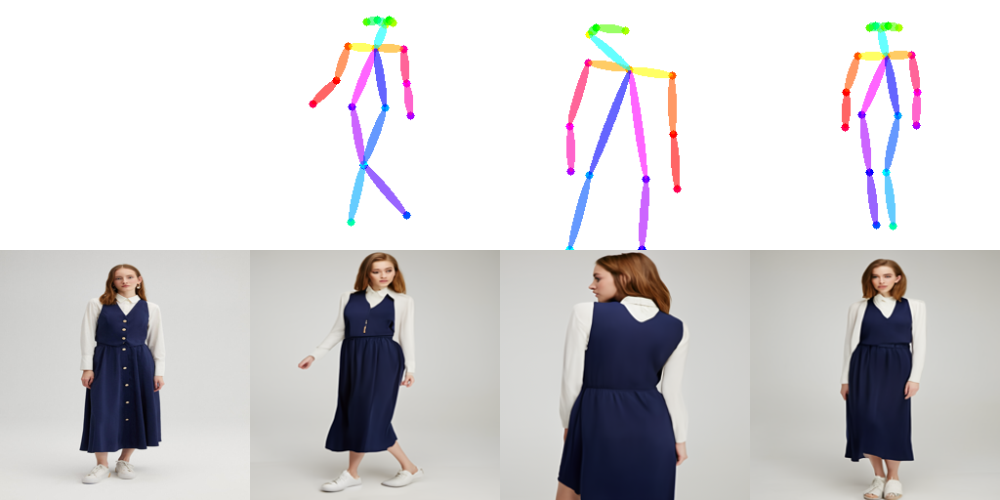

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_10_4.png' is not a directory
Resim 10 için Pose 4 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_10_4.png


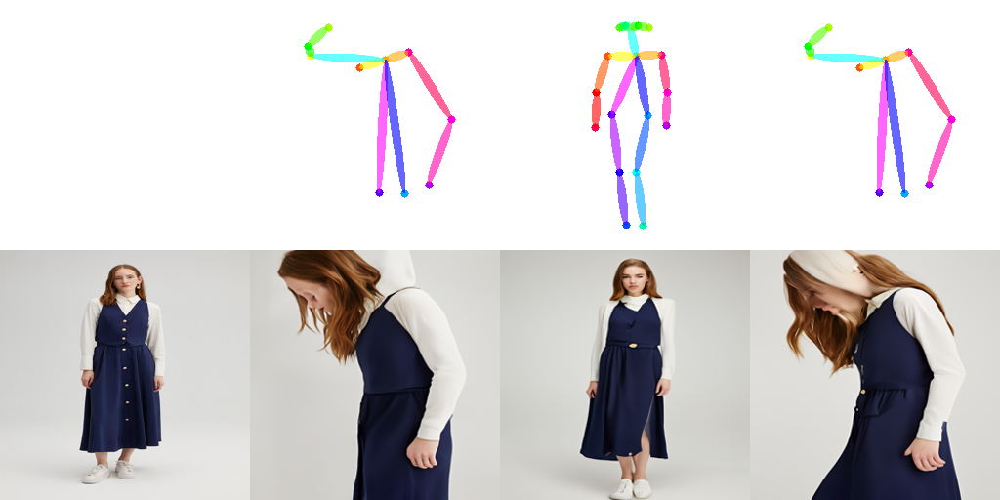

40it [00:37,  1.08it/s]


cp: target 'Notebooks/images/pose_11_1.png' is not a directory
Resim 11 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_11_1.png


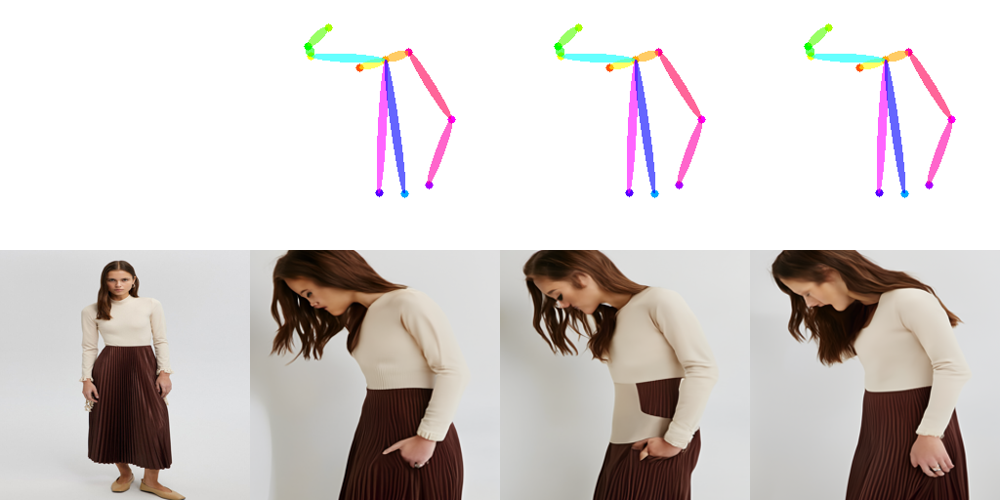

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_11_2.png' is not a directory
Resim 11 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_11_2.png


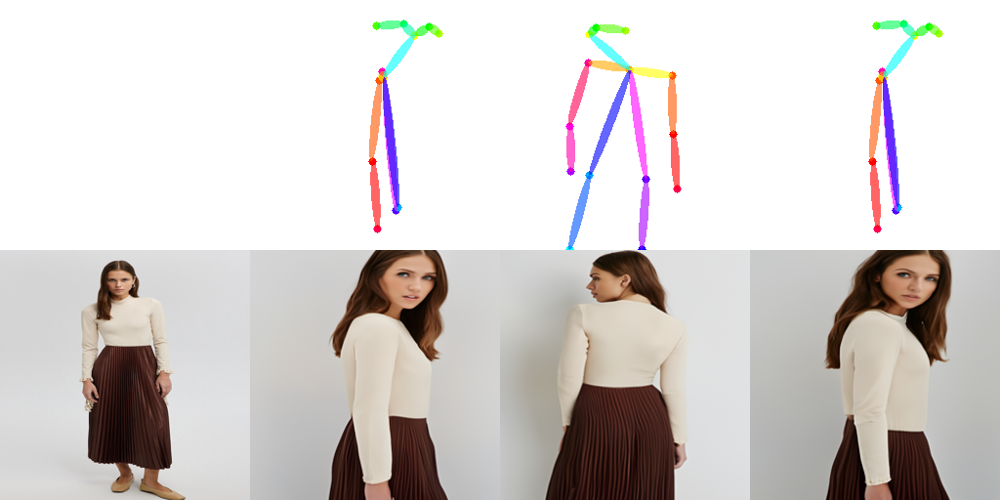

40it [00:36,  1.09it/s]


cp: target 'Notebooks/images/pose_11_3.png' is not a directory
Resim 11 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_11_3.png


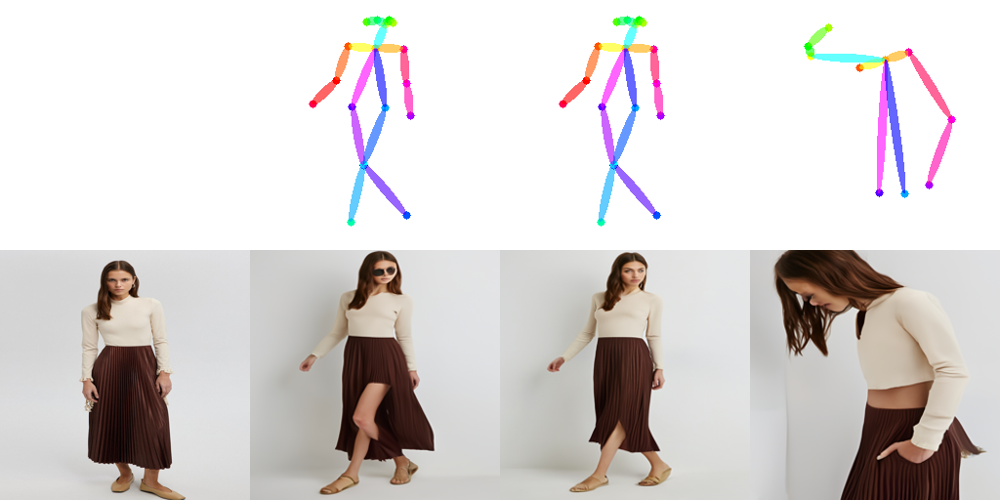

40it [00:37,  1.08it/s]


cp: target 'Notebooks/images/pose_11_4.png' is not a directory
Resim 11 için Pose 4 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_11_4.png


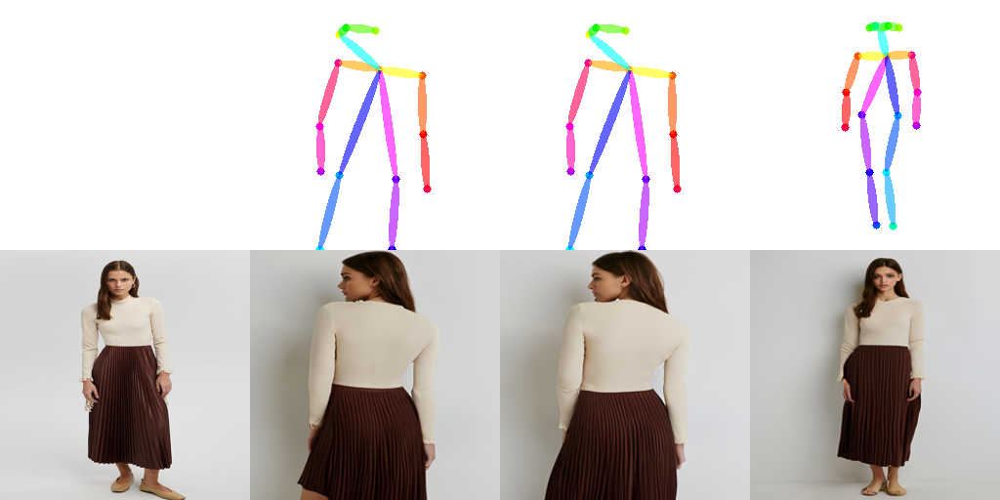

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_12_1.png' is not a directory
Resim 12 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_12_1.png


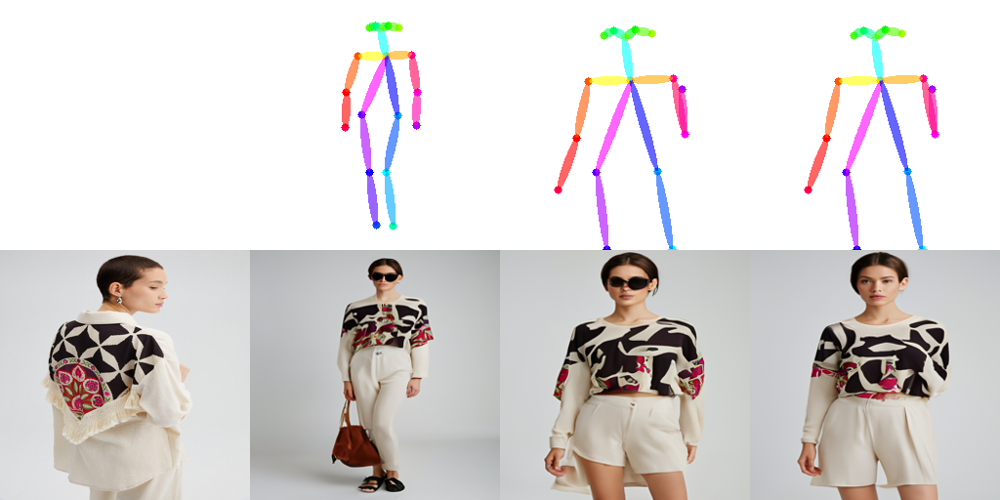

40it [00:37,  1.08it/s]


cp: target 'Notebooks/images/pose_12_2.png' is not a directory
Resim 12 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_12_2.png


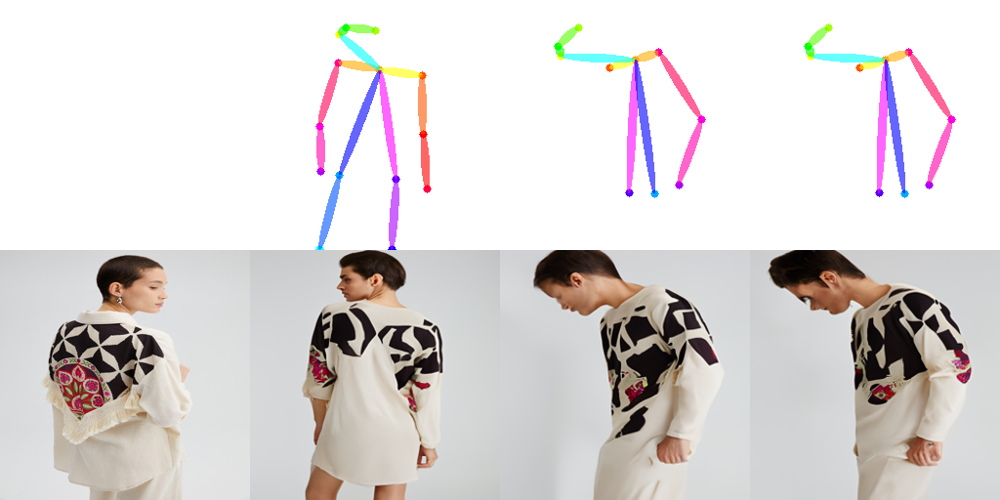

40it [00:37,  1.08it/s]


cp: target 'Notebooks/images/pose_12_3.png' is not a directory
Resim 12 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_12_3.png


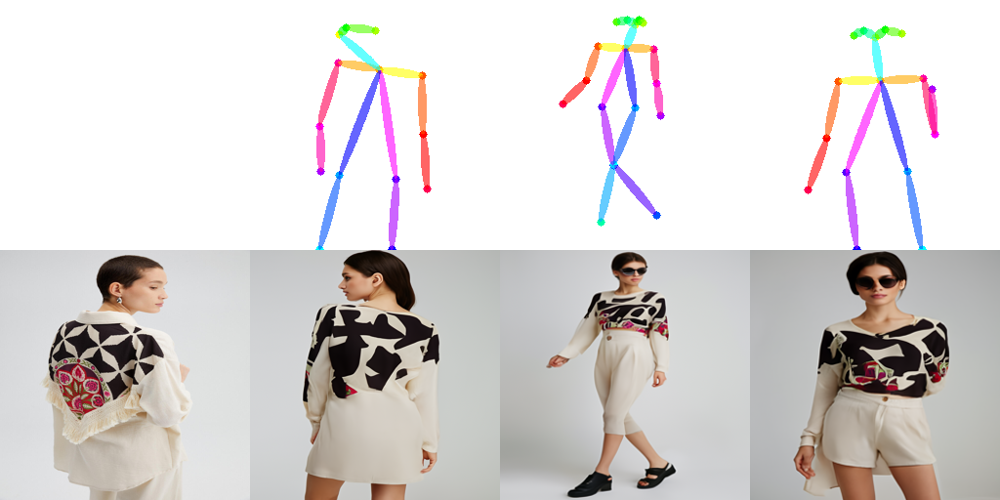

40it [00:37,  1.08it/s]


cp: target 'Notebooks/images/pose_12_4.png' is not a directory
Resim 12 için Pose 4 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_12_4.png


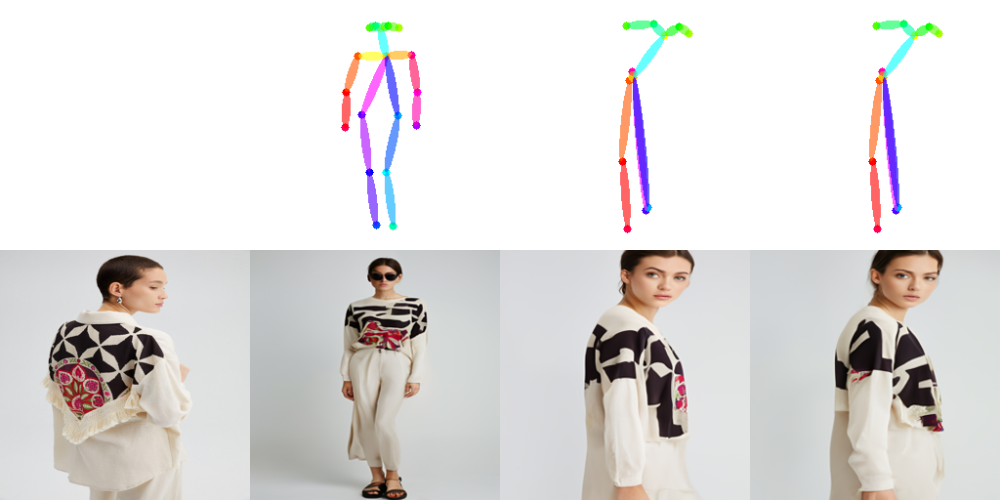

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_13_1.png' is not a directory
Resim 13 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_13_1.png


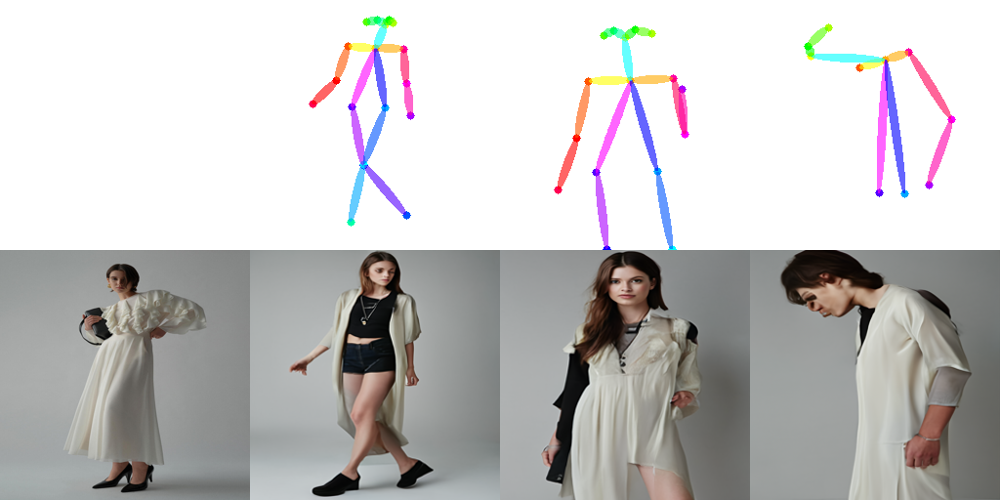

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_13_2.png' is not a directory
Resim 13 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_13_2.png


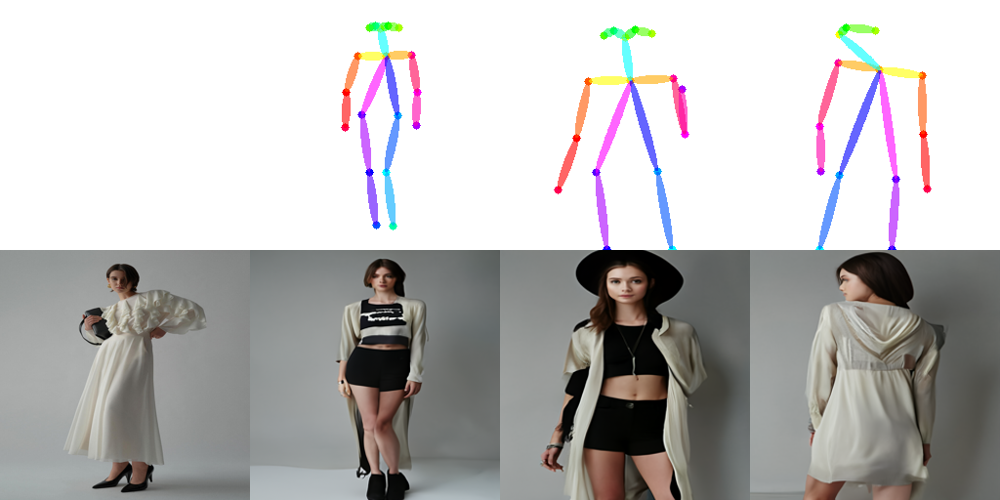

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_13_3.png' is not a directory
Resim 13 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_13_3.png


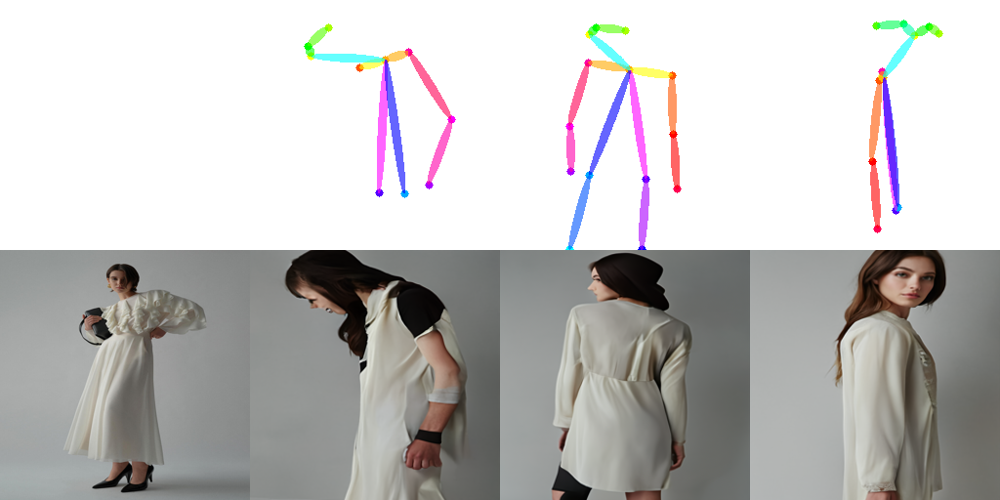

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_13_4.png' is not a directory
Resim 13 için Pose 4 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_13_4.png


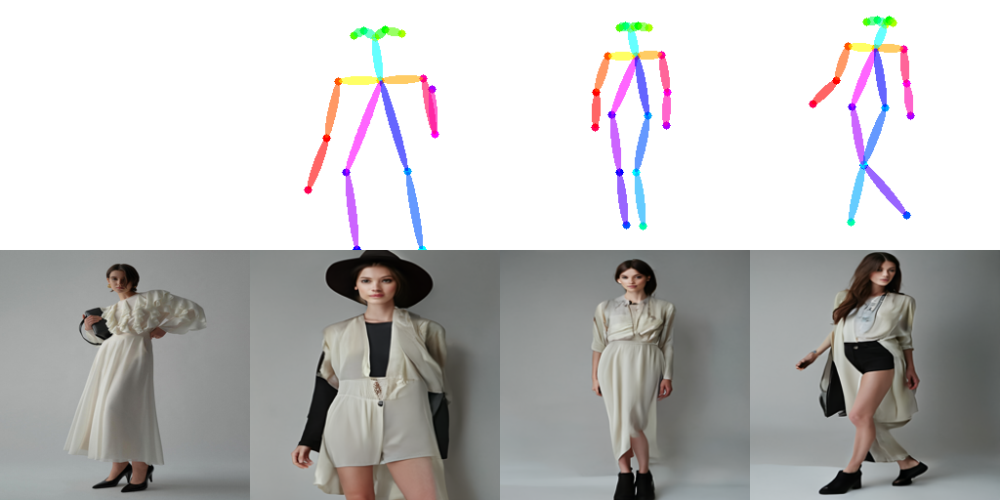

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_14_1.png' is not a directory
Resim 14 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_14_1.png


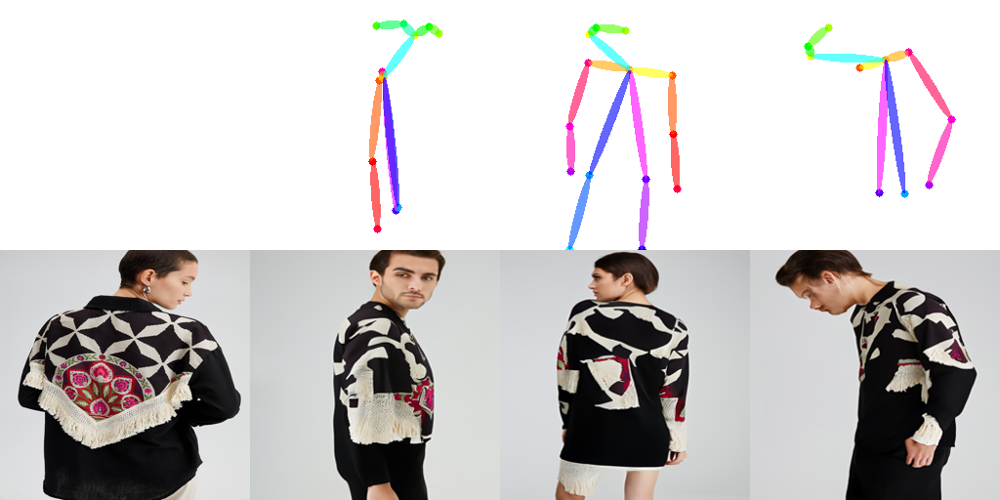

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_14_2.png' is not a directory
Resim 14 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_14_2.png


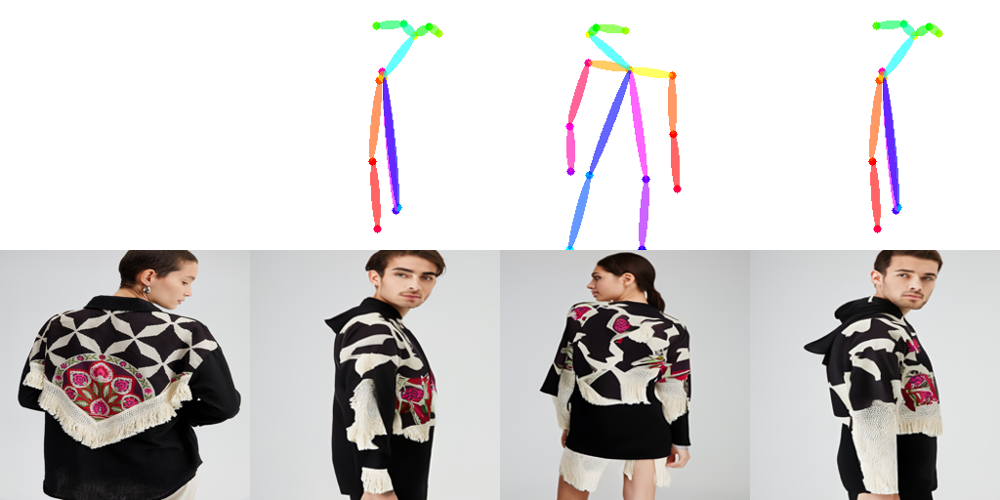

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_14_3.png' is not a directory
Resim 14 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_14_3.png


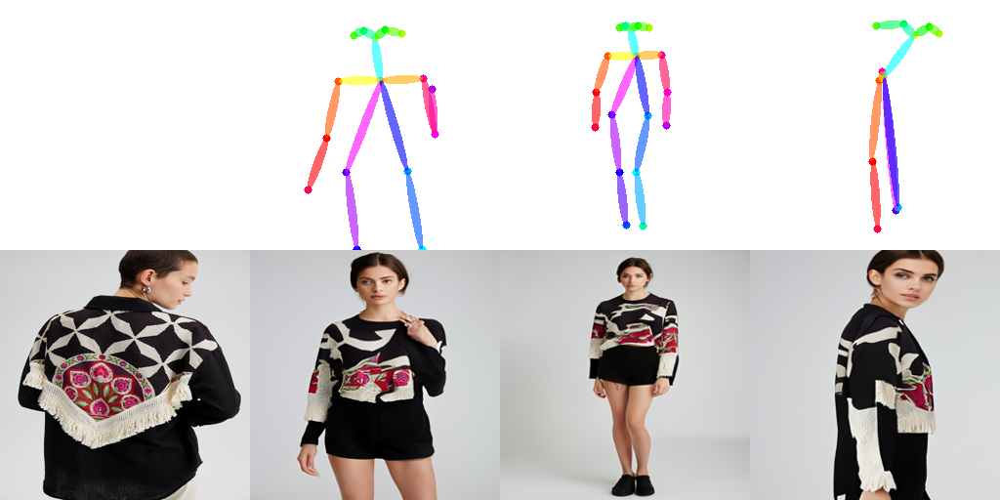

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_14_4.png' is not a directory
Resim 14 için Pose 4 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_14_4.png


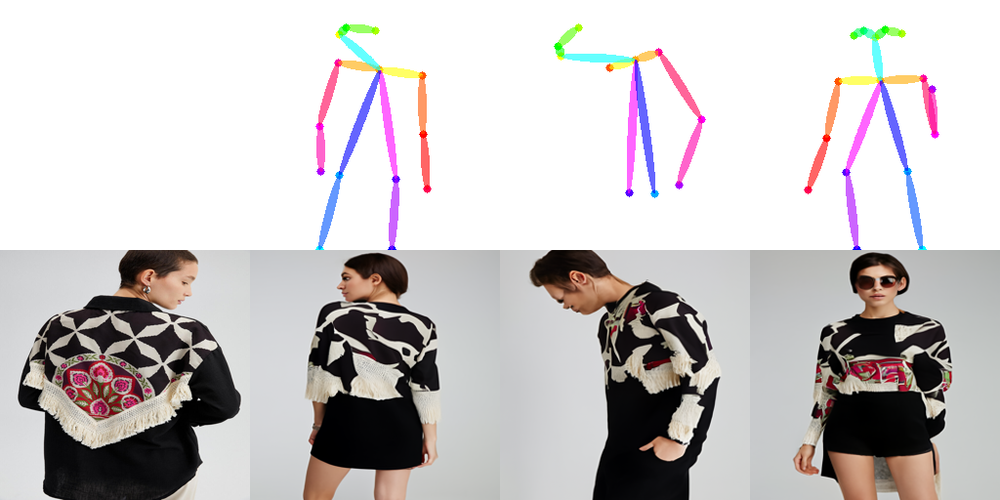

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_15_1.png' is not a directory
Resim 15 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_15_1.png


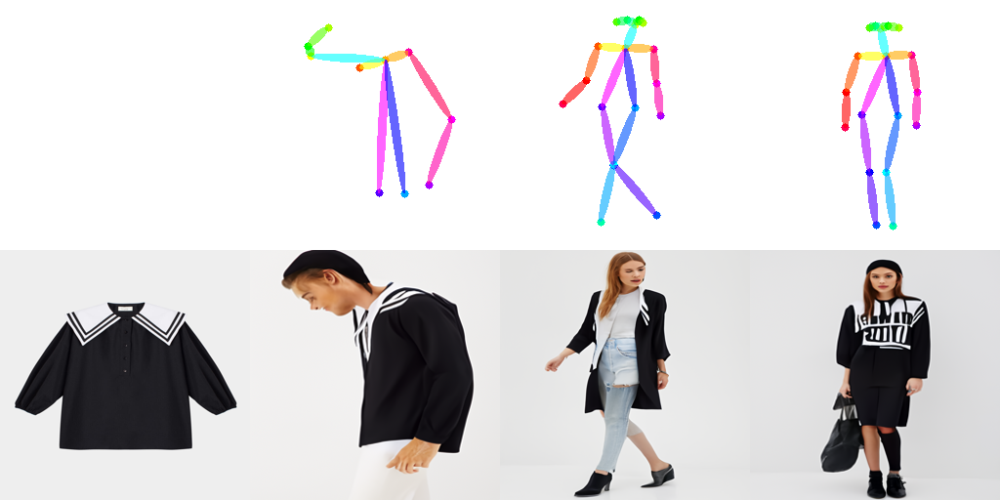

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_15_2.png' is not a directory
Resim 15 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_15_2.png


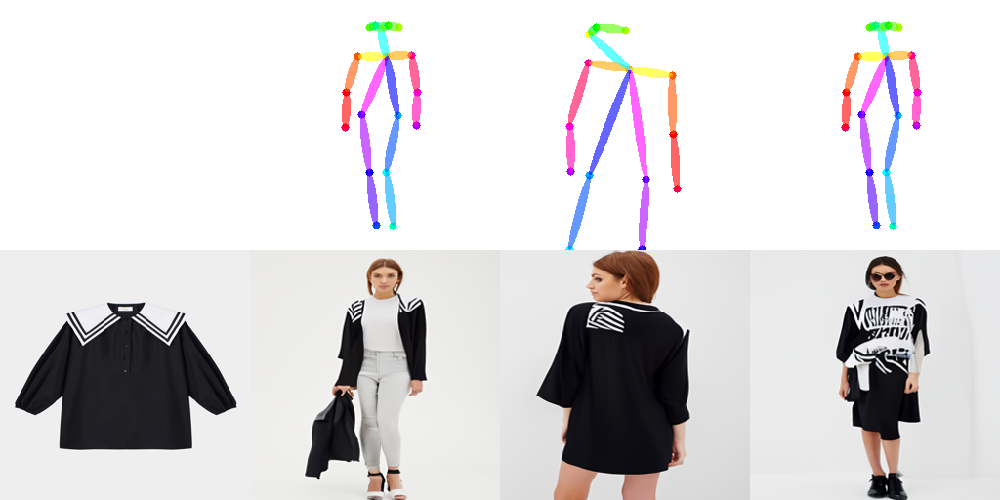

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_15_3.png' is not a directory
Resim 15 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_15_3.png


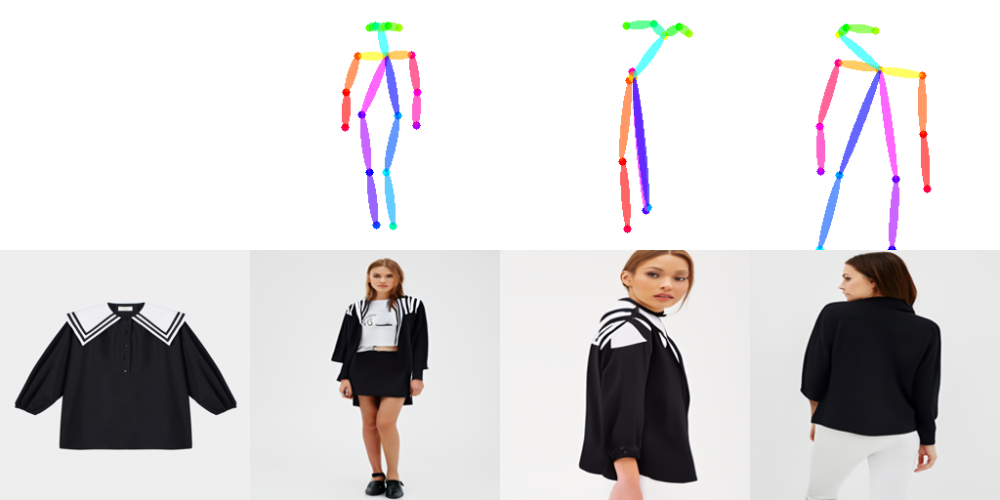

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_15_4.png' is not a directory
Resim 15 için Pose 4 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_15_4.png


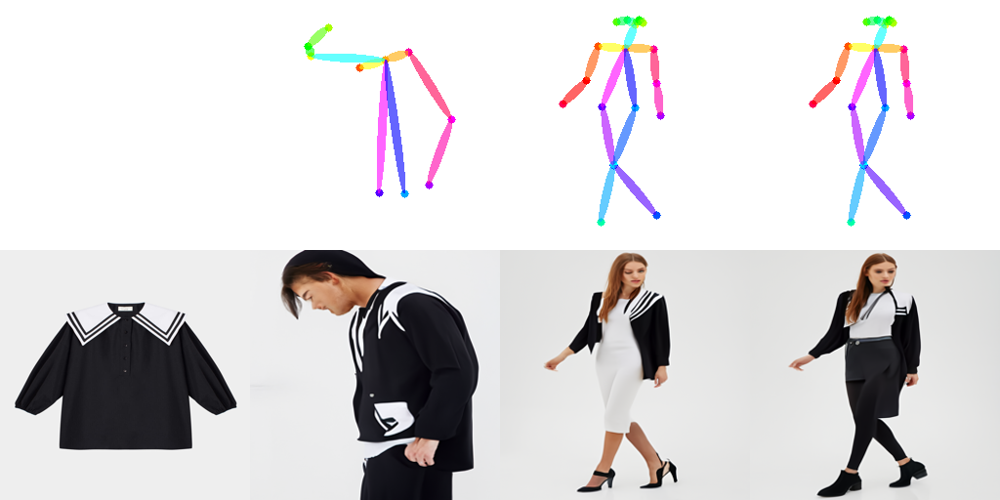

40it [00:36,  1.09it/s]


cp: target 'Notebooks/images/pose_16_1.png' is not a directory
Resim 16 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_16_1.png


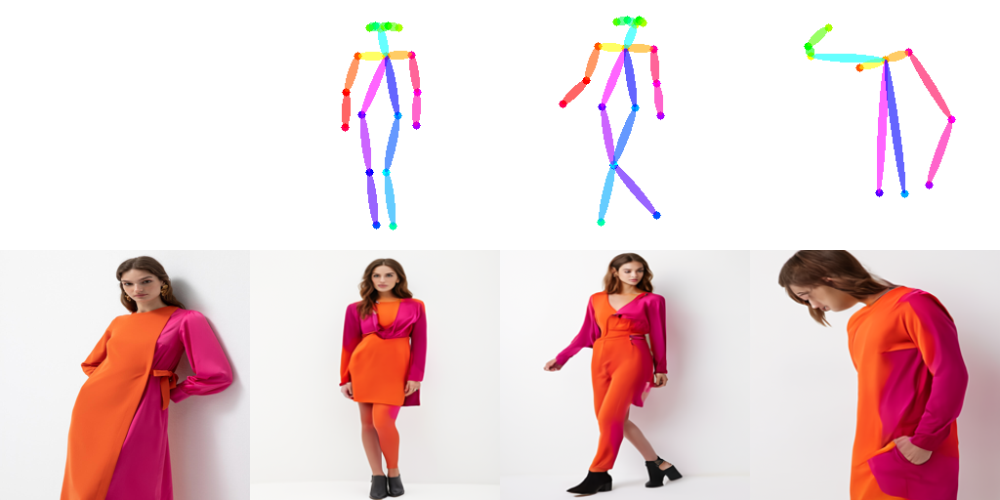

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_16_2.png' is not a directory
Resim 16 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_16_2.png


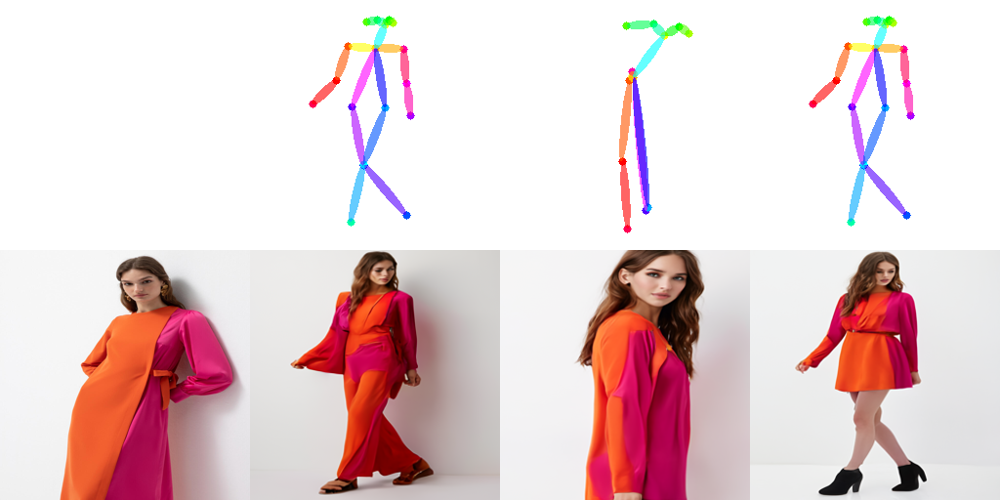

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_16_3.png' is not a directory
Resim 16 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_16_3.png


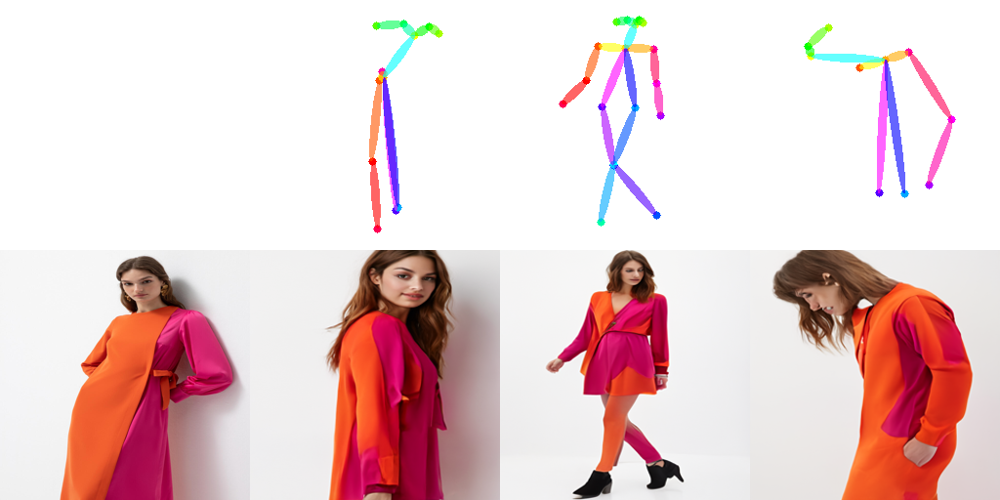

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_16_4.png' is not a directory
Resim 16 için Pose 4 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_16_4.png


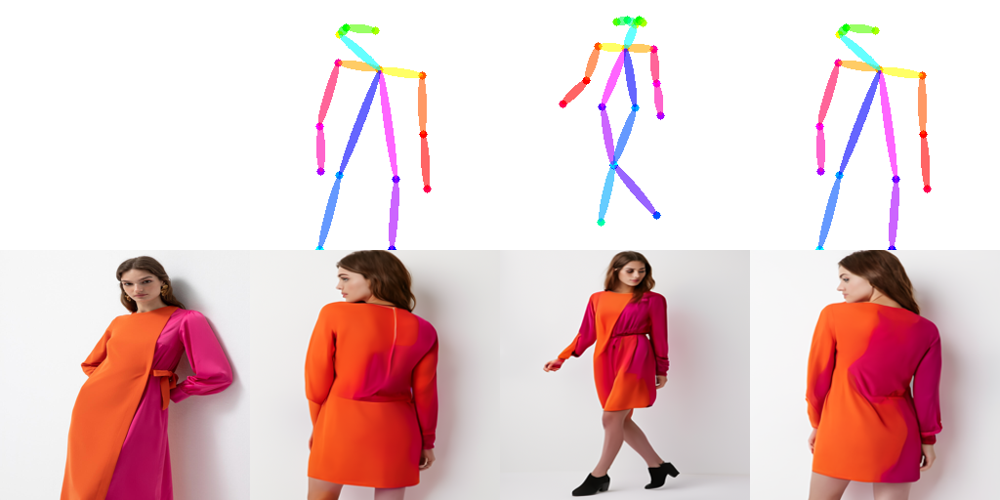

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_17_1.png' is not a directory
Resim 17 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_17_1.png


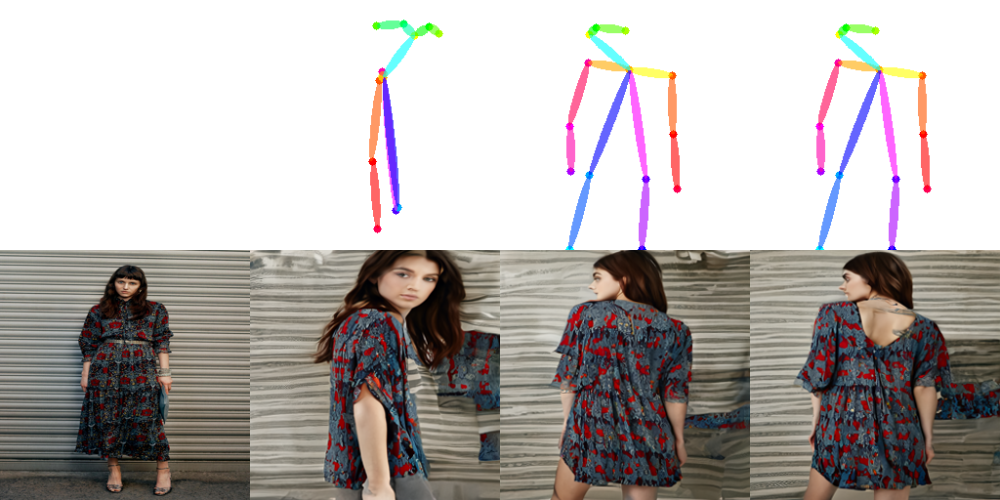

40it [00:37,  1.08it/s]


cp: target 'Notebooks/images/pose_17_2.png' is not a directory
Resim 17 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_17_2.png


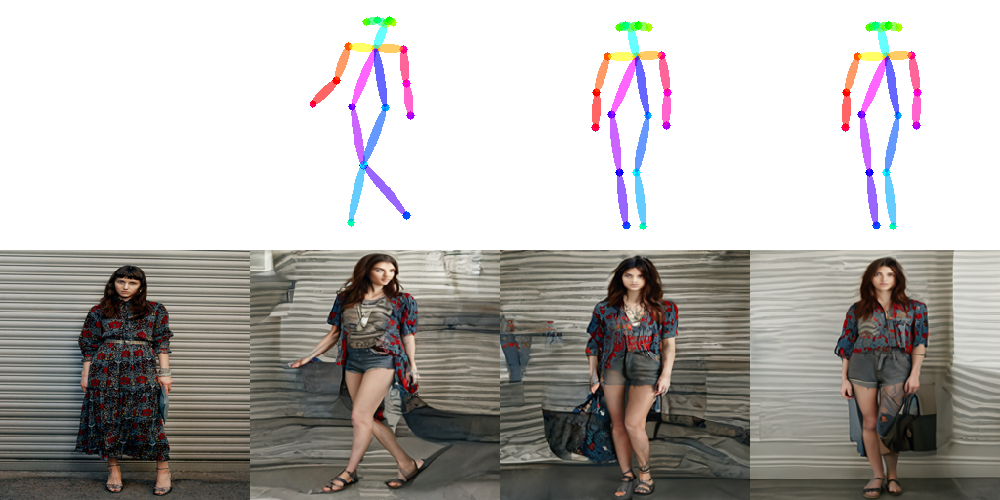

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_17_3.png' is not a directory
Resim 17 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_17_3.png


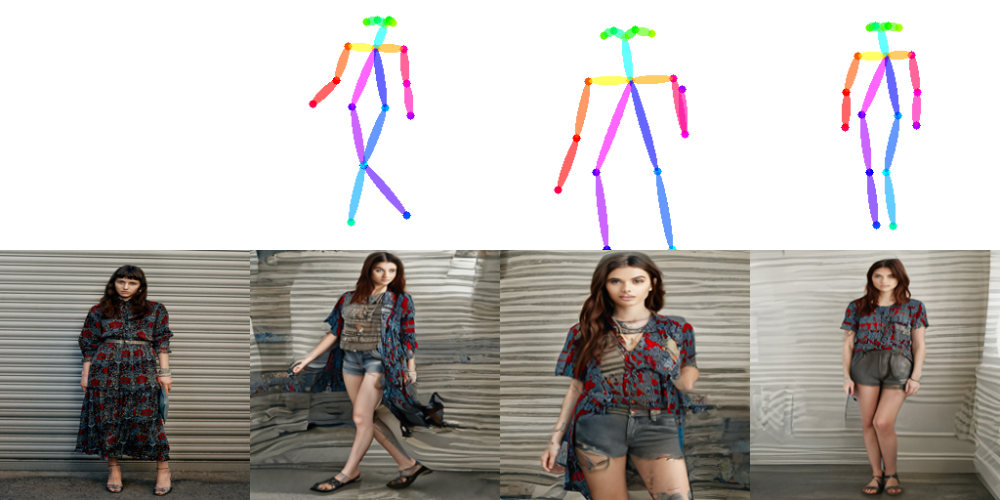

40it [00:36,  1.09it/s]


cp: target 'Notebooks/images/pose_17_4.png' is not a directory
Resim 17 için Pose 4 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_17_4.png


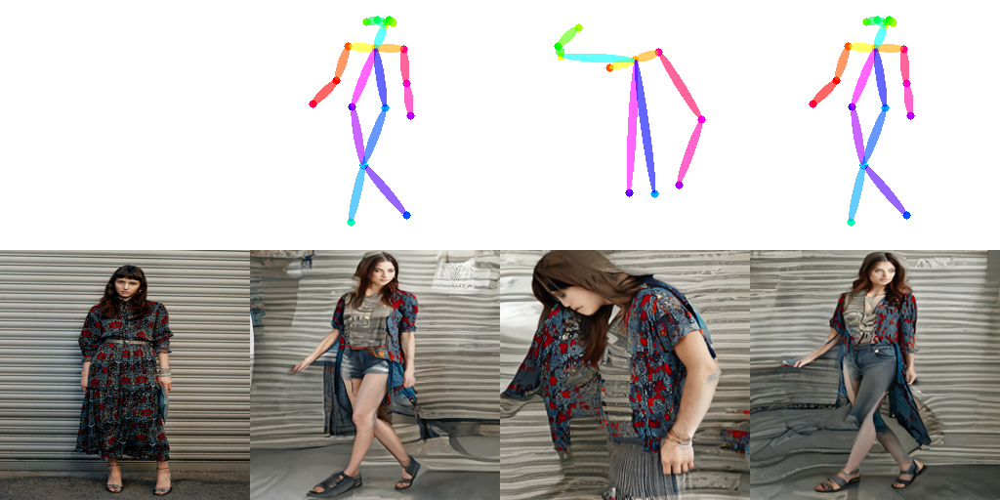

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_18_1.png' is not a directory
Resim 18 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_18_1.png


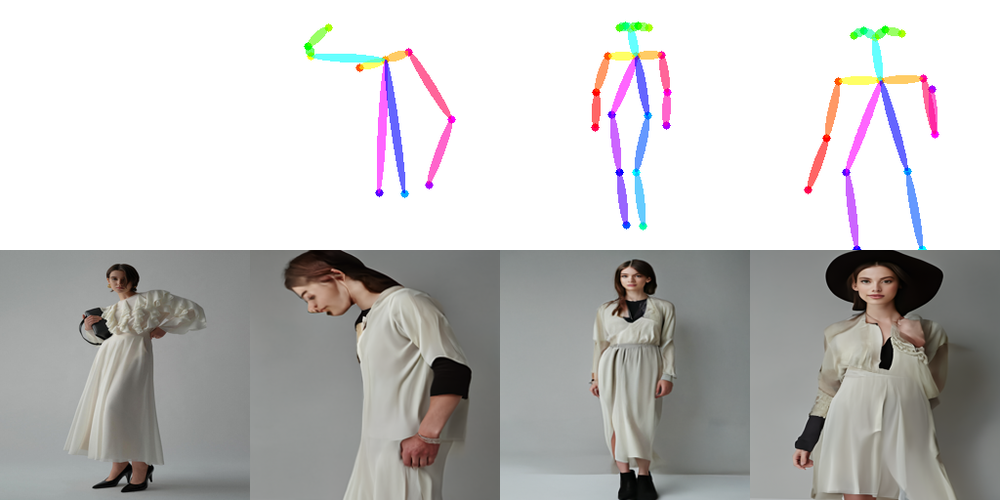

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_18_2.png' is not a directory
Resim 18 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_18_2.png


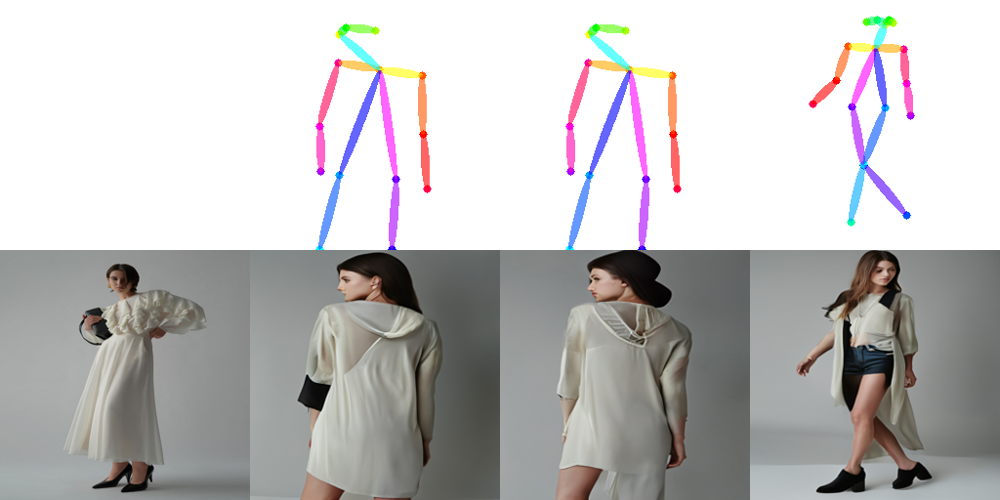

40it [00:36,  1.09it/s]


cp: target 'Notebooks/images/pose_18_3.png' is not a directory
Resim 18 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_18_3.png


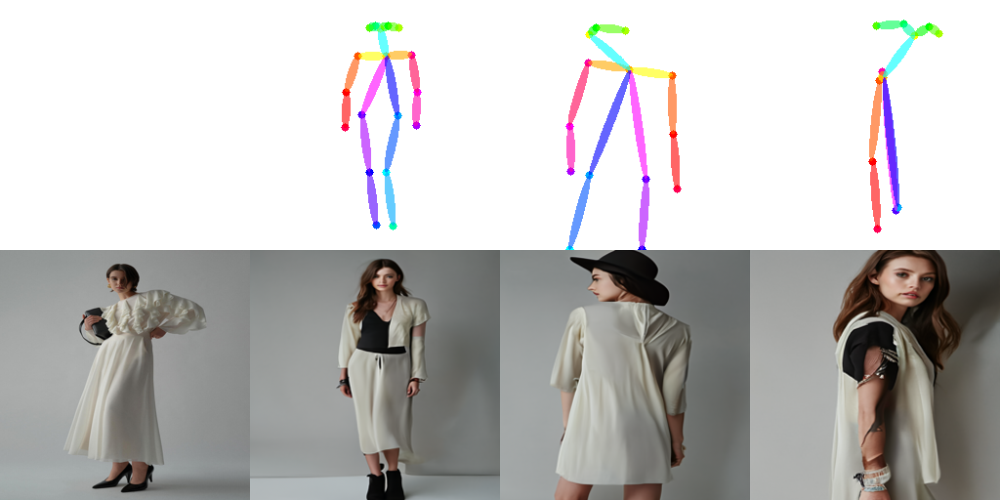

40it [00:36,  1.09it/s]


cp: target 'Notebooks/images/pose_18_4.png' is not a directory
Resim 18 için Pose 4 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_18_4.png


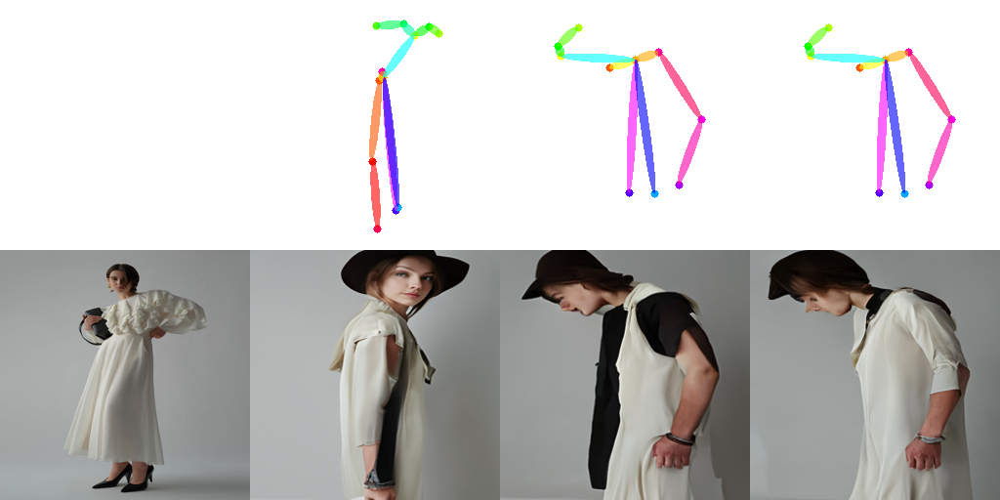

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_19_1.png' is not a directory
Resim 19 için Pose 1 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_19_1.png


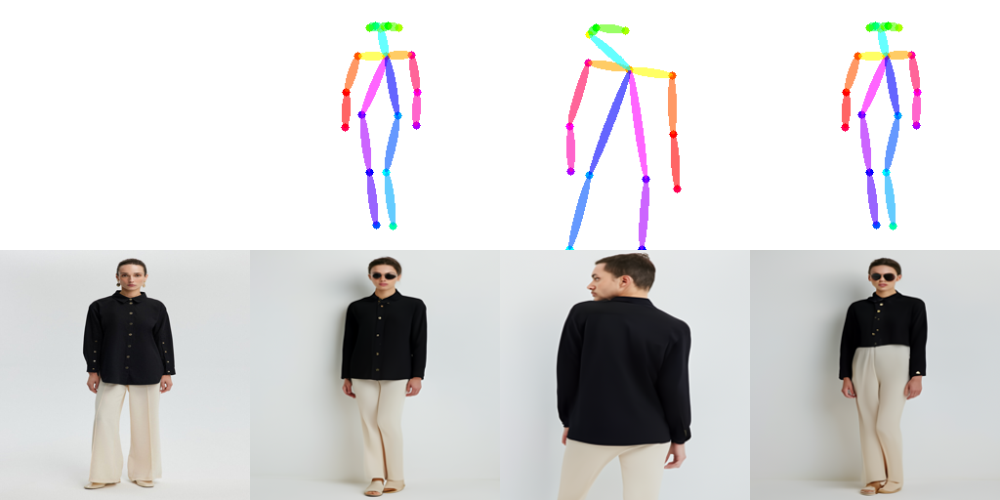

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_19_2.png' is not a directory
Resim 19 için Pose 2 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_19_2.png


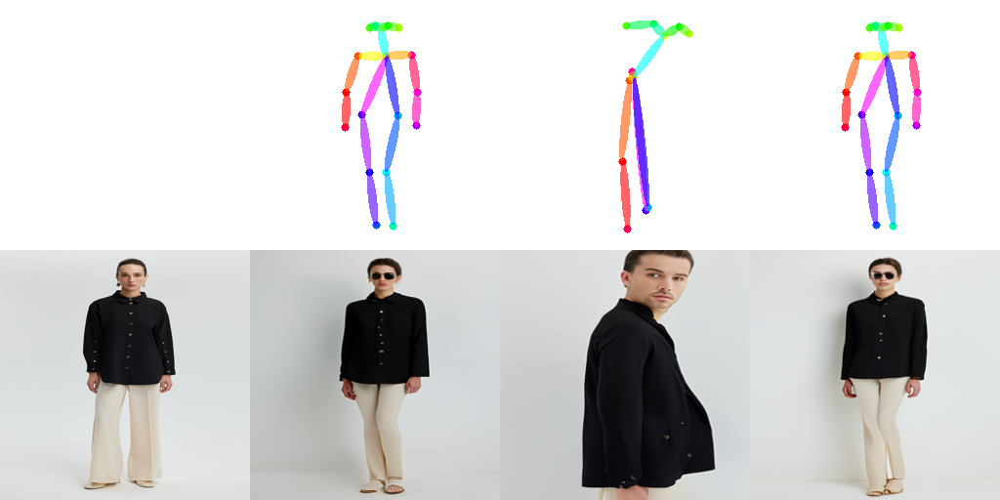

40it [00:36,  1.08it/s]


cp: target 'Notebooks/images/pose_19_3.png' is not a directory
Resim 19 için Pose 3 Google Drive'a kaydedildi: /content/drive/MyDrive/Colab Notebooks/images/pose_19_3.png


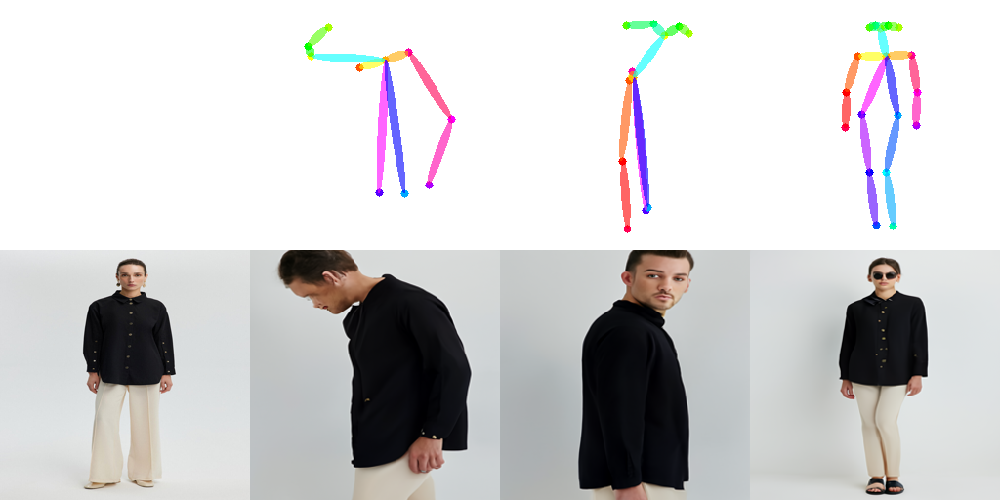

37it [00:34,  1.08it/s]

In [ ]:
import os
import pandas as pd
import requests
from io import BytesIO
from PIL import Image as PILImage
from google.colab import drive, files
from predict import Predictor
from IPython.display import Image

# Google Drive'a kaydedilecek dizini belirleyin
drive_output_dir = '/content/drive/MyDrive/Colab Notebooks/images/'
os.makedirs(drive_output_dir, exist_ok=True)

# Google Drive'ı bağlayın


# CSV dosyasını yükleyin
csv_path = '/content/data.csv'  # CSV dosyanızın yolu
df = pd.read_csv(csv_path)

# Predictor objesi oluştur
obj = Predictor()

# İlk 100 resim için işlemi gerçekleştirin
for index, row in df.iterrows():
    if index >= 100:  # İlk 100 satırı işlemek için
        break

    image_url = row['SecenekResim2']  # Resmin URL'sini al
    try:
        # URL'den resmi indirin
        response = requests.get(image_url)
        input_image = PILImage.open(BytesIO(response.content)).convert('RGB')

        # Dönüştürülmüş görüntüyü geçici bir dosya olarak kaydedin
        rgb_path = f'temp_rgb_image_{index}.png'
        input_image.save(rgb_path)

        # Pozları oluştur ve her birini ayrı dosyaya kaydedin

            obj.predict_pose(image=rgb_path, sample_algorithm='ddim', num_poses=3, nsteps=)

            # Sonuç olarak 'output.png' dosyasını yeniden adlandırarak kaydedin
            output_image_path = f'output_pose_{index}_{i+1}.png'
            !mv output.png {output_image_path}

            # Google Drive'a kaydetme
            drive_save_path = os.path.join(drive_output_dir, f'pose_{index}_{i+1}.png')
            !cp {output_image_path} {drive_save_path}

            # Kaydedilen dosyanın yolunu gösterin
            print(f"Resim {index} için Pose {i+1} Google Drive'a kaydedildi: {drive_save_path}")

            # Sonucu görüntülemek için
            display(Image(output_image_path))

    except Exception as e:
        print(f"Resim {image_url} işlenirken bir hata oluştu: {e}")


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


----checkpoints loaded from path: /content/cloth_segm.pth----
Processing image 1: https://cdn.privetouche.com/product/1024/1024/23S1T044_195_23S_09_04.jpg
Transparent image saved to ./output/transparent_image_1.png
Saved image shape: (1535, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 17

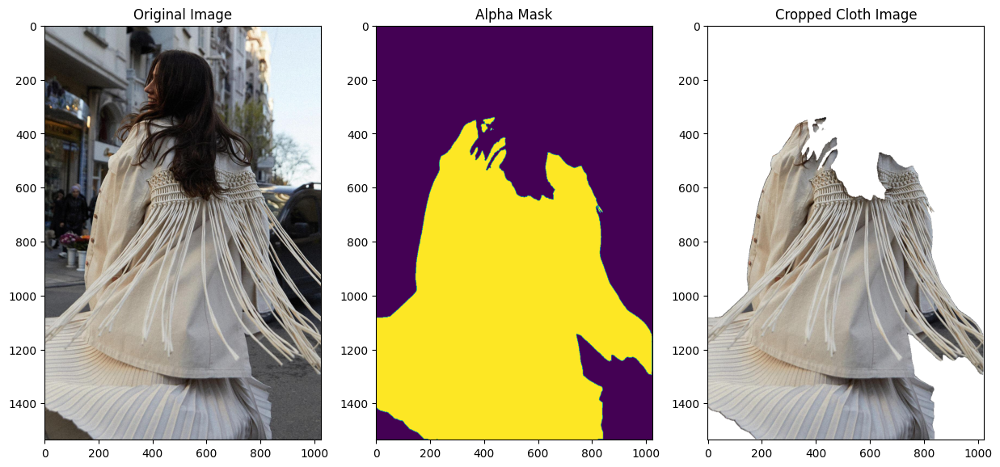

Processing image 2: https://cdn.privetouche.com/product/1024/1024/24S1R0004_101_24S_07_01.jpg
Transparent image saved to ./output/transparent_image_2.png
Saved image shape: (1536, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 19

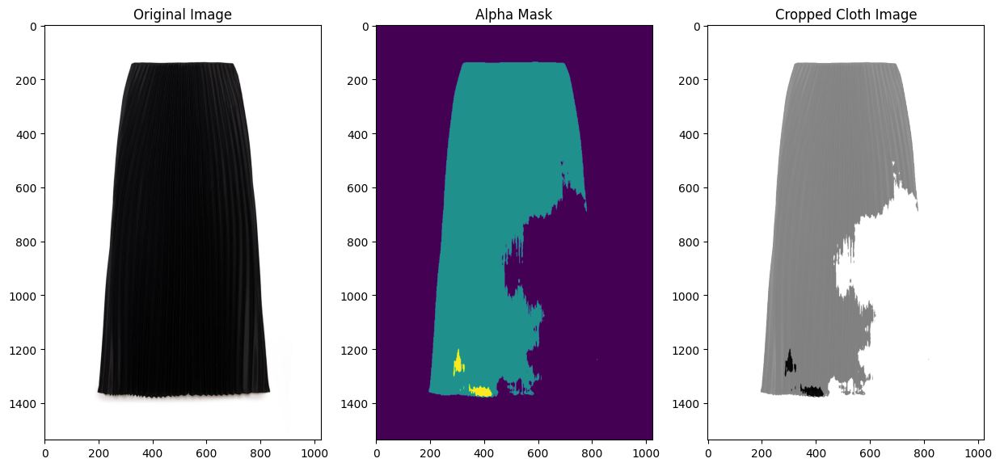

Processing image 3: https://cdn.privetouche.com/product/1024/1024/23Y1T076_195_23Y_11_01.jpg
Transparent image saved to ./output/transparent_image_3.png
Saved image shape: (1535, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 192

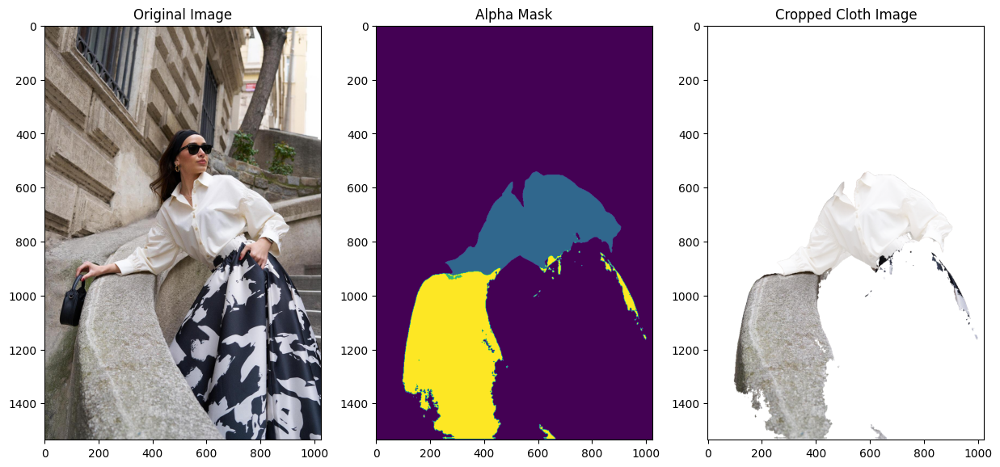

Processing image 4: https://cdn.privetouche.com/product/1024/1024/23S1T044_195_23S_09_04.jpg
Transparent image saved to ./output/transparent_image_4.png
Saved image shape: (1535, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 192

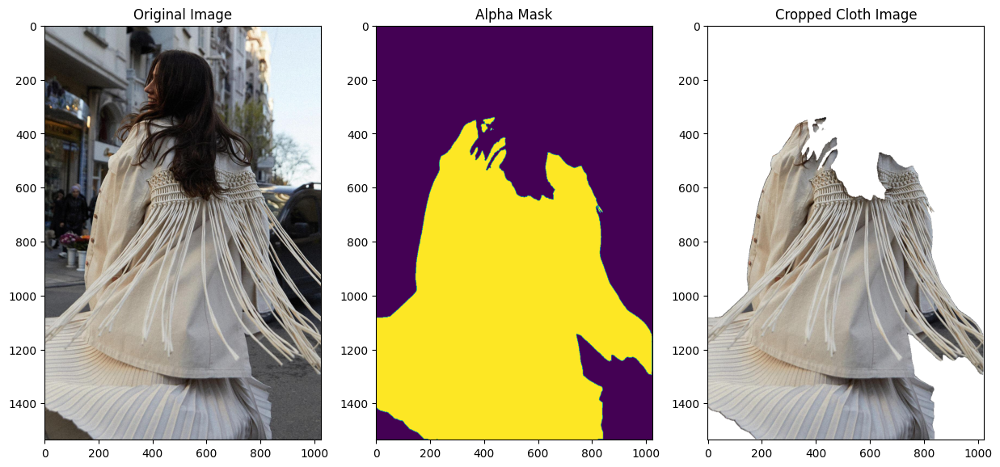

Processing image 5: https://cdn.privetouche.com/product/1024/1024/24S1R0004_102_24S_07_01.jpg
Transparent image saved to ./output/transparent_image_5.png
Saved image shape: (1536, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 19

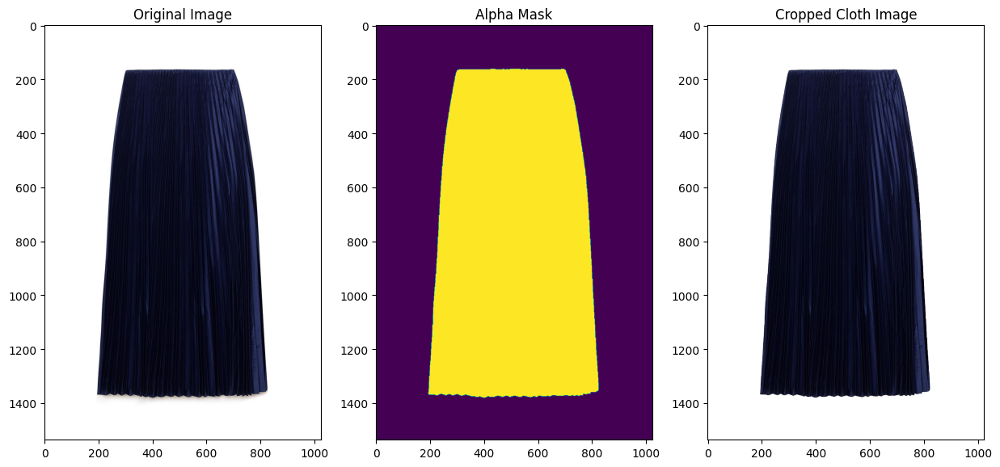

Processing image 6: https://cdn.privetouche.com/product/1024/1024/23S1C029_101_23S_01_03.jpg
Transparent image saved to ./output/transparent_image_6.png
Saved image shape: (1536, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 192

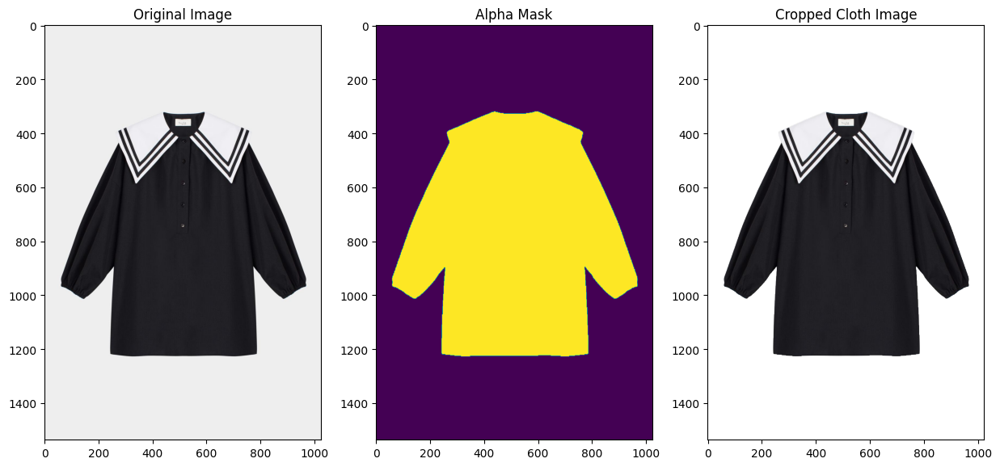

Processing image 7: https://cdn.privetouche.com/product/1024/1024/23F1X001_144_23F_01_01.jpg
Transparent image saved to ./output/transparent_image_7.png
Saved image shape: (1536, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 192

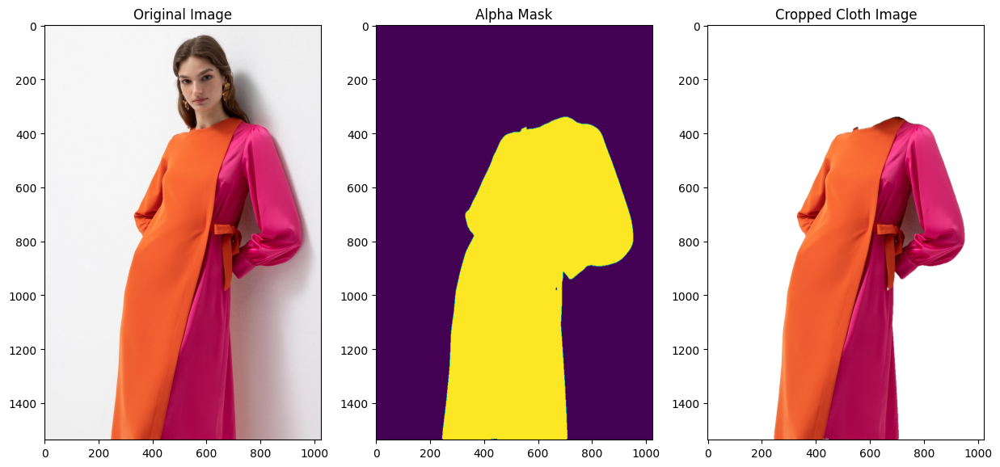

Processing image 8: https://cdn.privetouche.com/product/1024/1024/23F1X001_144_23F_01_01.jpg
Transparent image saved to ./output/transparent_image_8.png
Saved image shape: (1536, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 192

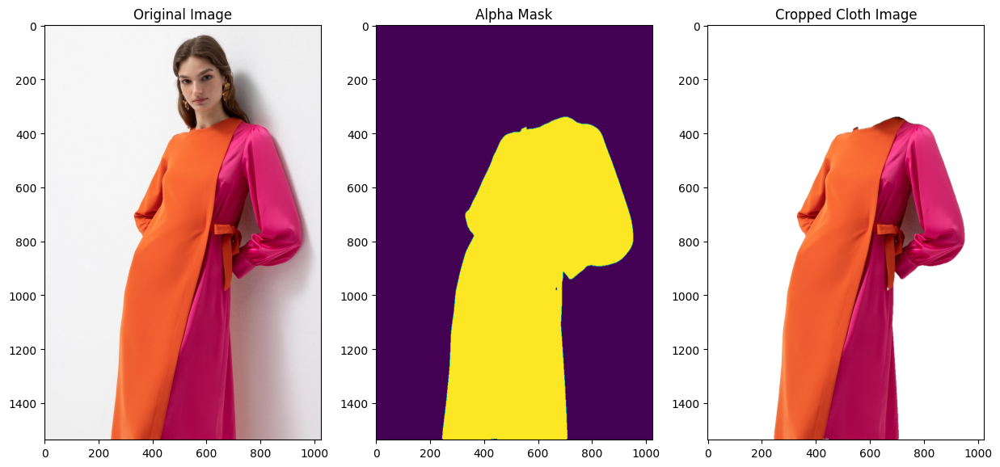

Processing image 9: https://cdn.privetouche.com/product/1024/1024/24S1R0004_152_24S_01_01.jpg
Transparent image saved to ./output/transparent_image_9.png
Saved image shape: (1536, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 19

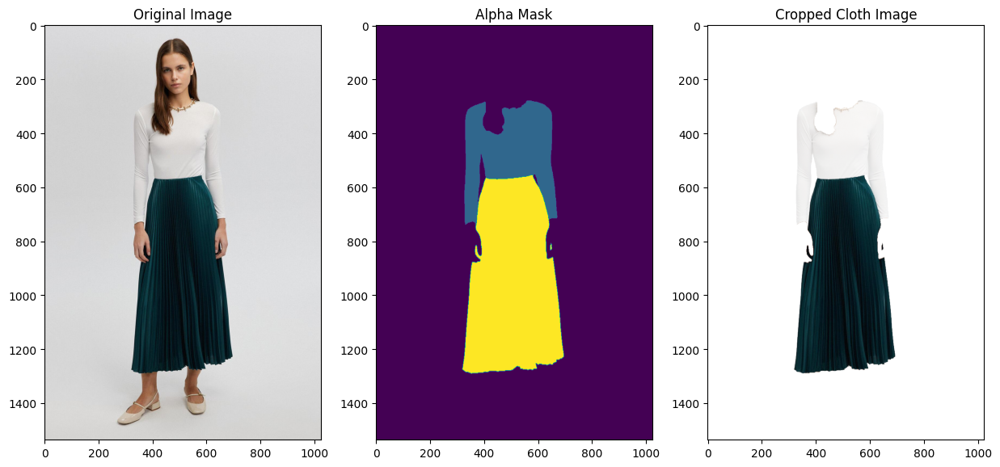

Processing image 10: https://cdn.privetouche.com/product/1024/1024/23Y1CR030_137_23Y_01_01.jpg
Transparent image saved to ./output/transparent_image_10.png
Saved image shape: (1536, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 

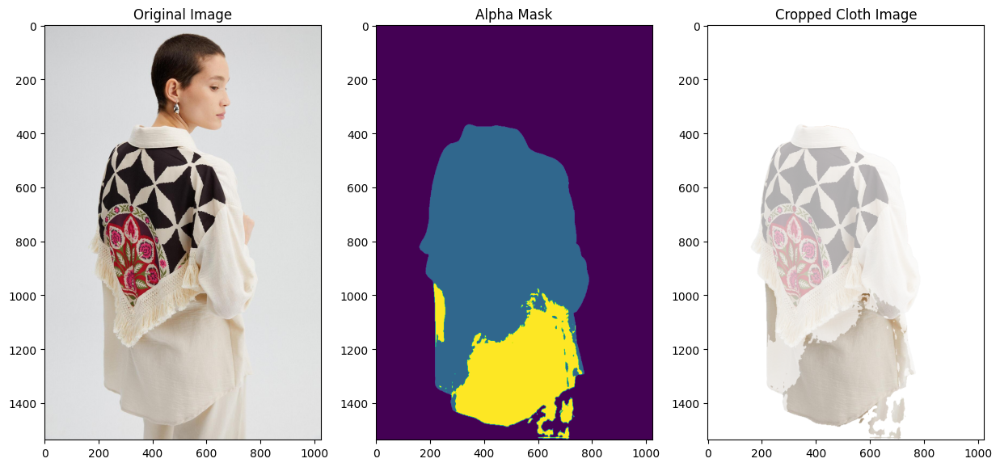

Processing image 11: https://cdn.privetouche.com/product/1024/1024/23Y1T062_102_23Y_01_01.jpg
Transparent image saved to ./output/transparent_image_11.png
Saved image shape: (1536, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 1

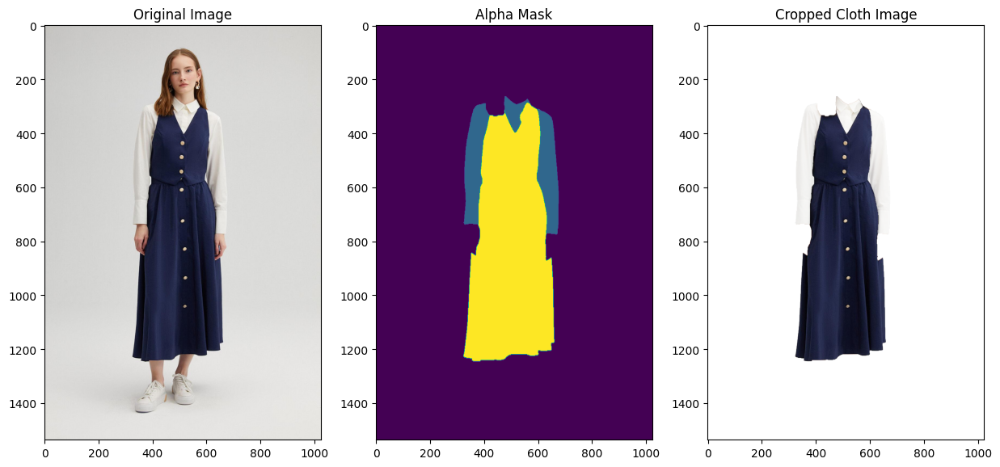

Processing image 12: https://cdn.privetouche.com/product/1024/1024/24S1R0004_275_24S_01_01.jpg
Transparent image saved to ./output/transparent_image_12.png
Saved image shape: (1536, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 

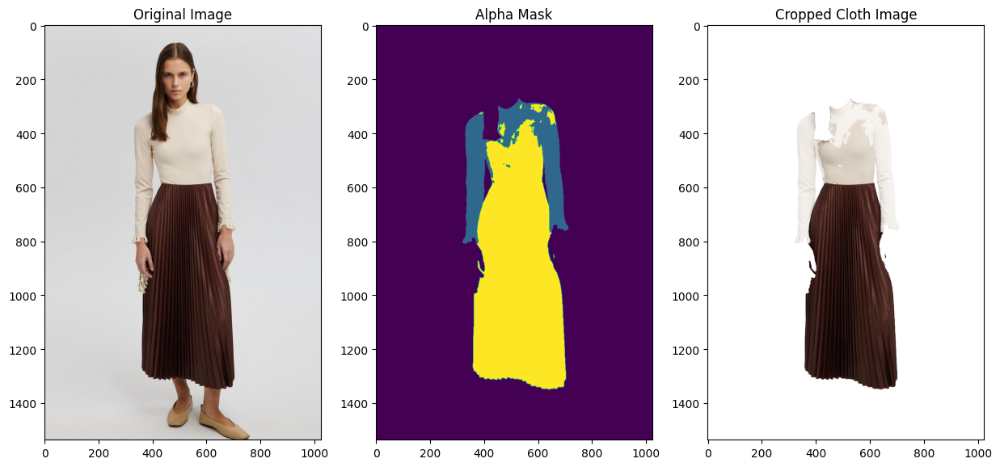

Processing image 13: https://cdn.privetouche.com/product/1024/1024/23Y1CR030_137_23Y_01_01.jpg
Transparent image saved to ./output/transparent_image_13.png
Saved image shape: (1536, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 

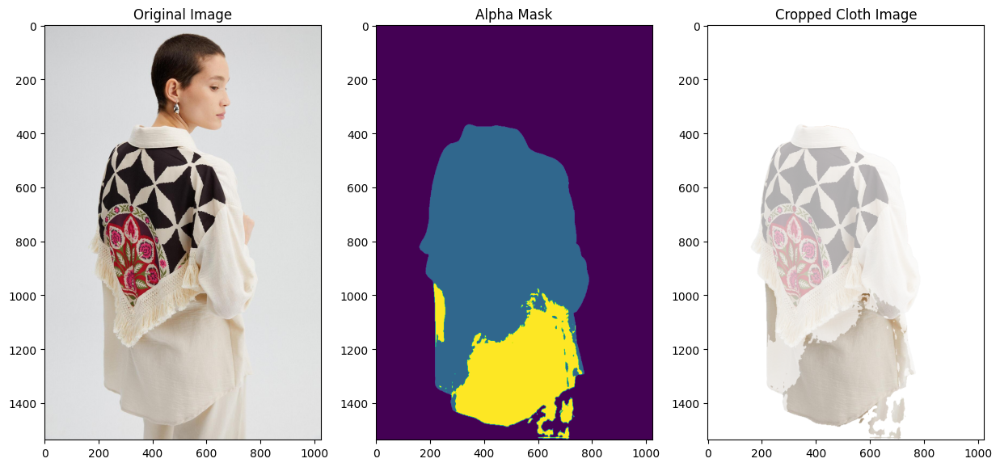

Processing image 14: https://cdn.privetouche.com/product/1024/1024/24S1S0007_195_24S_06_01.jpg
Transparent image saved to ./output/transparent_image_14.png
Saved image shape: (1535, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 

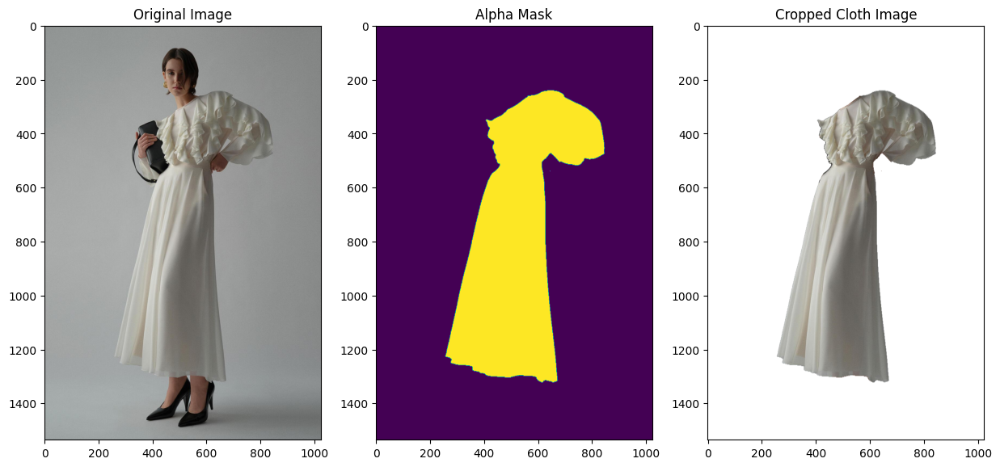

Processing image 15: https://cdn.privetouche.com/product/1024/1024/23Y1CR030_101_23Y_01_01.jpg
Transparent image saved to ./output/transparent_image_15.png
Saved image shape: (1536, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 

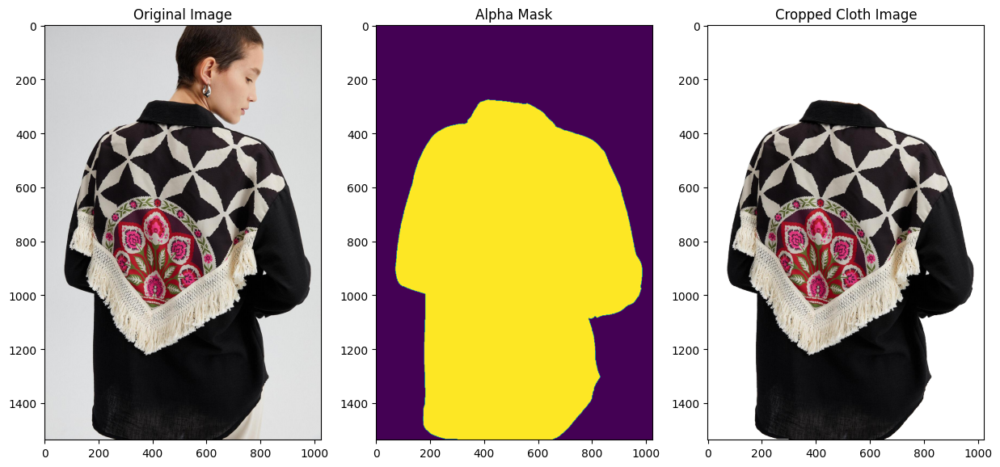

Processing image 16: https://cdn.privetouche.com/product/1024/1024/23S1C029_101_23S_01_03.jpg
Transparent image saved to ./output/transparent_image_16.png
Saved image shape: (1536, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 1

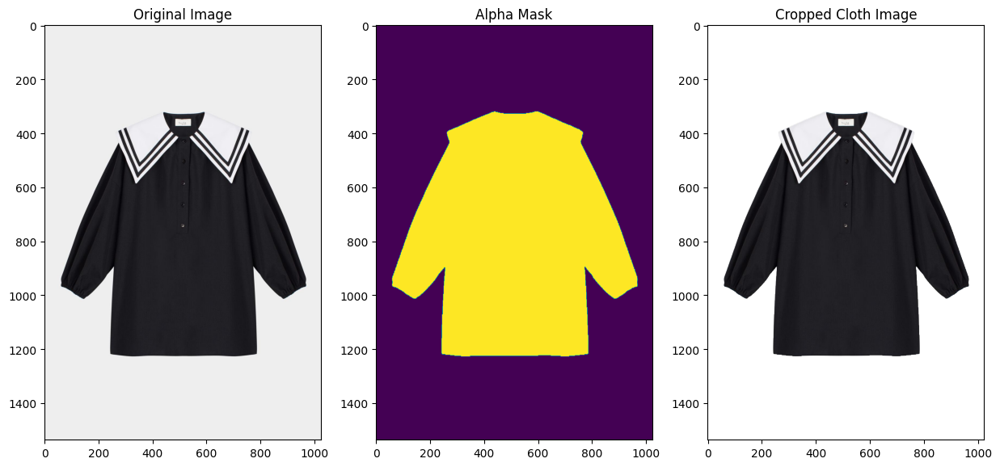

Processing image 17: https://cdn.privetouche.com/product/1024/1024/23F1X001_144_23F_01_01.jpg
Transparent image saved to ./output/transparent_image_17.png
Saved image shape: (1536, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 1

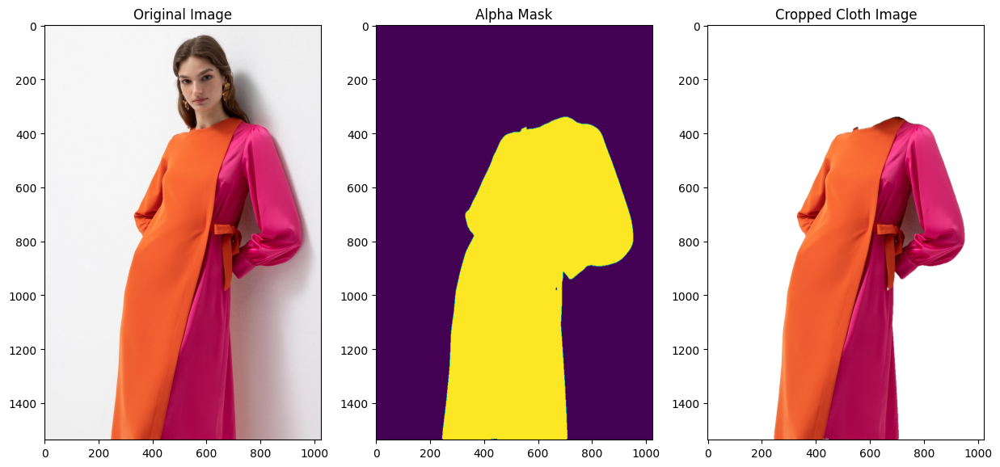

Processing image 18: https://cdn.privetouche.com/product/1024/1024/24Y1T0023_101_24Y_06_01.jpg
Transparent image saved to ./output/transparent_image_18.png
Saved image shape: (1535, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 

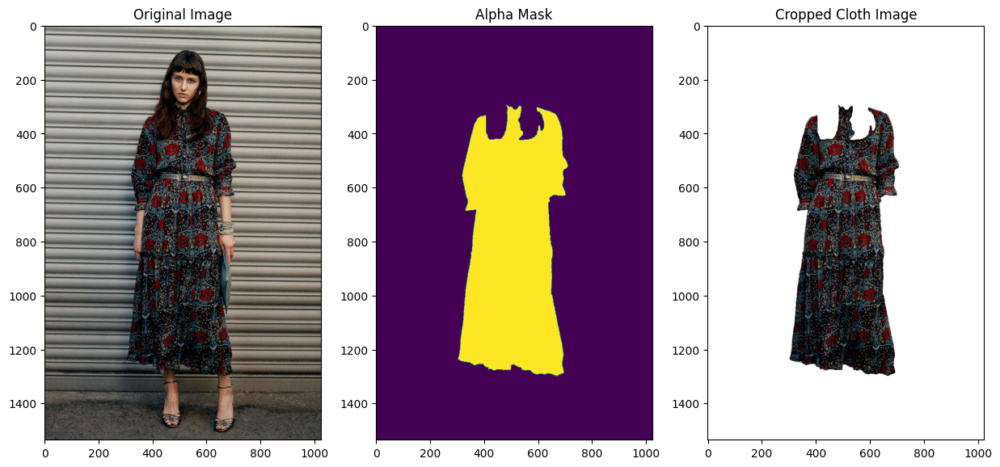

Processing image 19: https://cdn.privetouche.com/product/1024/1024/24S1S0007_195_24S_06_01.jpg
Transparent image saved to ./output/transparent_image_19.png
Saved image shape: (1535, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 

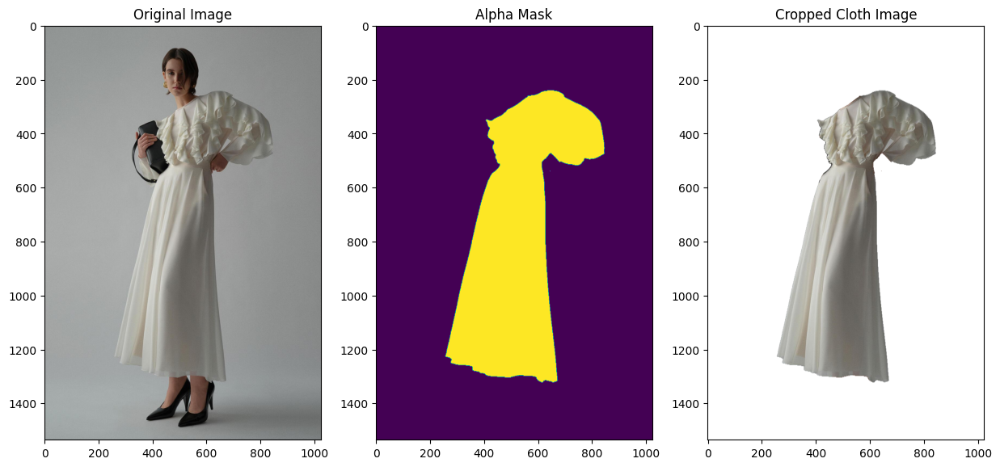

Processing image 20: https://cdn.privetouche.com/product/1024/1024/23F1X0105_101_23F_01_01.jpg
Transparent image saved to ./output/transparent_image_20.png
Saved image shape: (1536, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 

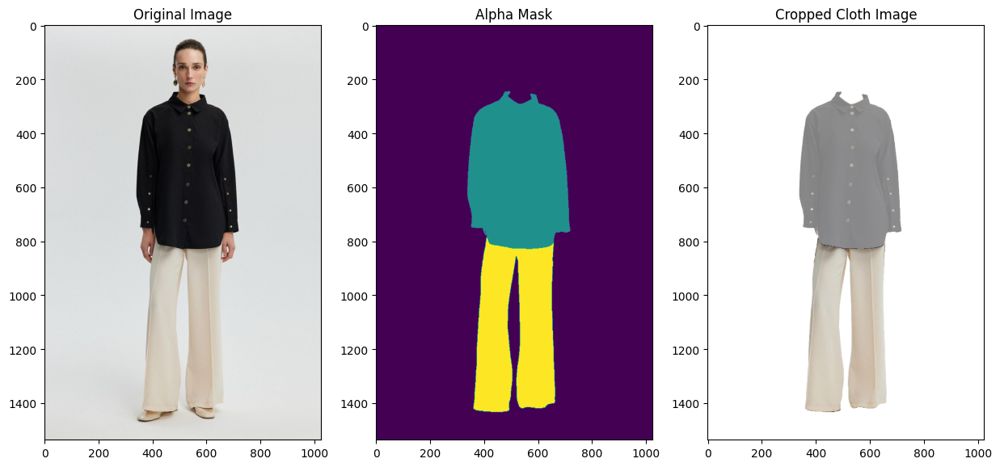

Processing image 21: https://cdn.privetouche.com/product/1024/1024/23Y1T062_101_23Y_01_01.jpg
Transparent image saved to ./output/transparent_image_21.png
Saved image shape: (1536, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 1

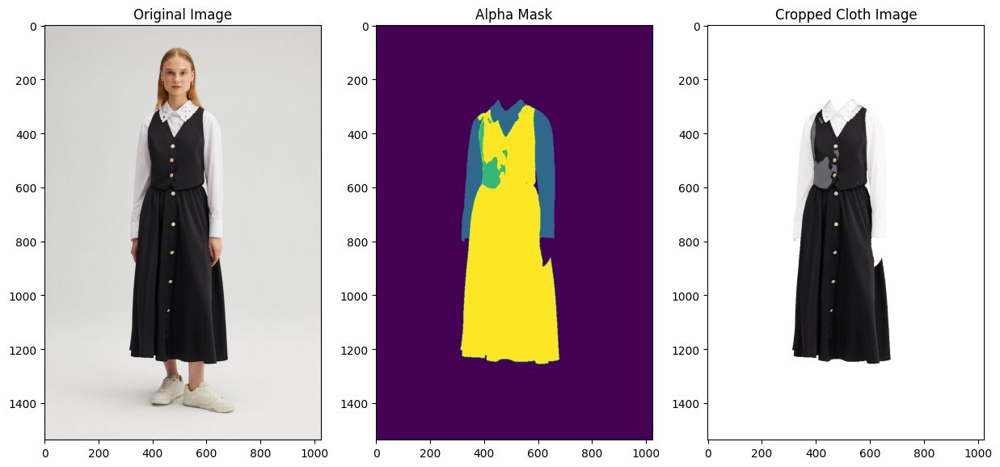

Processing image 22: https://cdn.privetouche.com/product/1024/1024/23Y1T076_195_23Y_11_01.jpg
Transparent image saved to ./output/transparent_image_22.png
Saved image shape: (1535, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 1

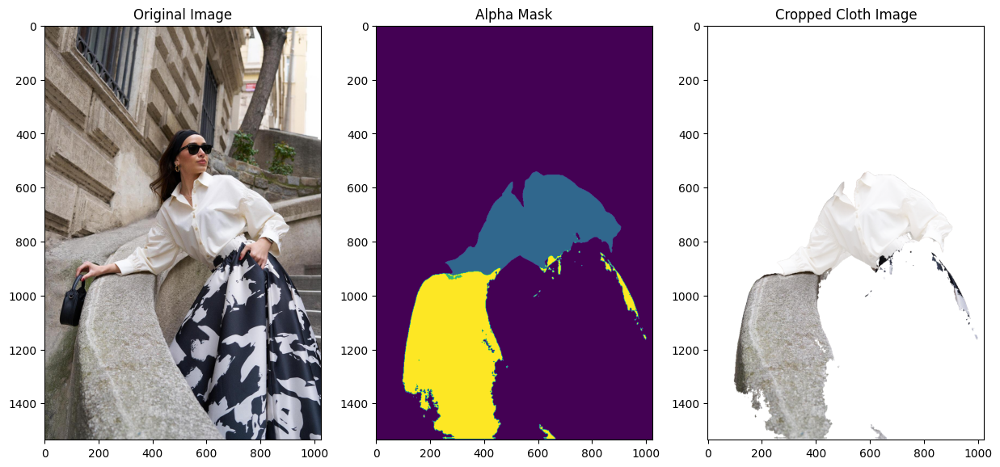

Processing image 23: https://cdn.privetouche.com/product/1024/1024/23Y1T062_102_23Y_01_01.jpg
Transparent image saved to ./output/transparent_image_23.png
Saved image shape: (1536, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 1

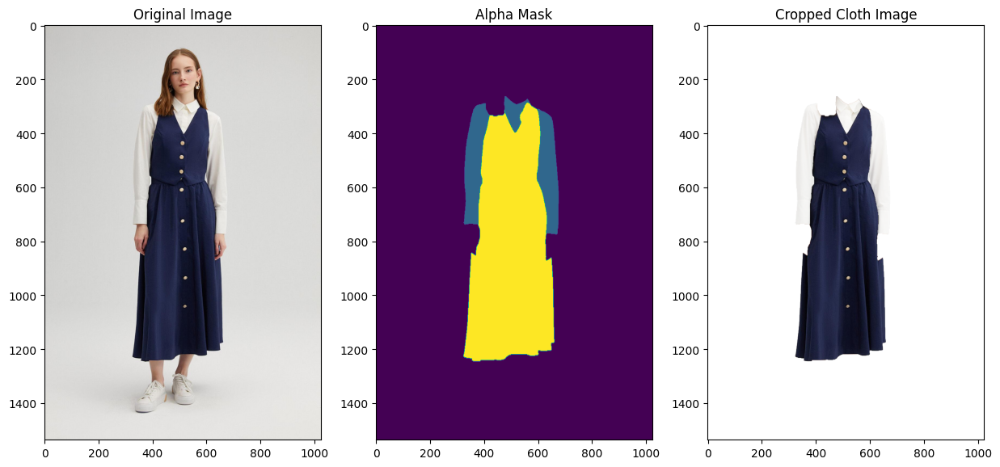

Processing image 24: https://cdn.privetouche.com/product/1024/1024/23Y1T062_101_23Y_01_01.jpg
Transparent image saved to ./output/transparent_image_24.png
Saved image shape: (1536, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 1

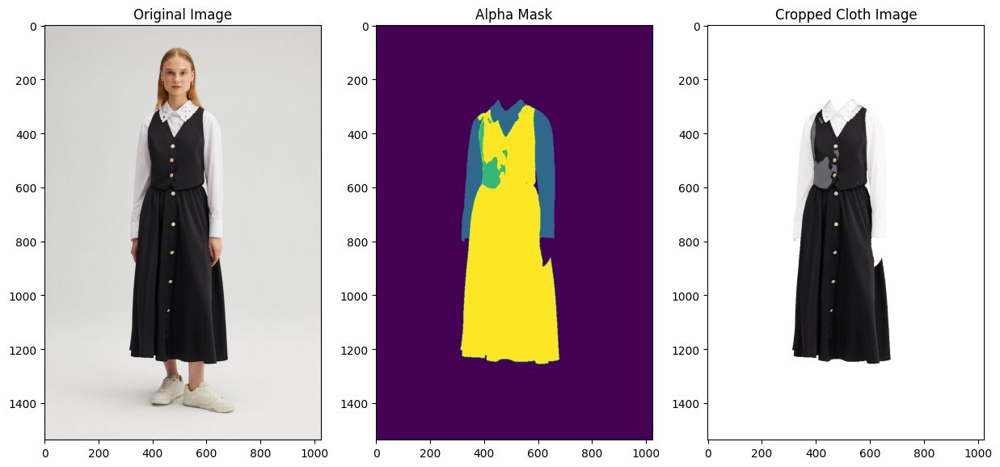

Processing image 25: https://cdn.privetouche.com/product/1024/1024/24S2S0010_101_24S_07_01.jpg
Transparent image saved to ./output/transparent_image_25.png
Saved image shape: (1535, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 

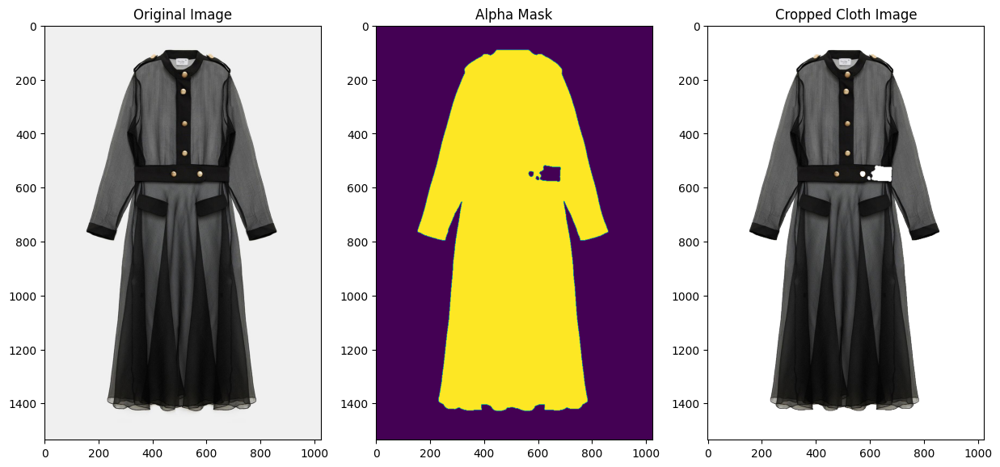

Processing image 26: https://cdn.privetouche.com/product/1024/1024/24Y1T0023_101_24Y_06_01.jpg
Transparent image saved to ./output/transparent_image_26.png
Saved image shape: (1535, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 

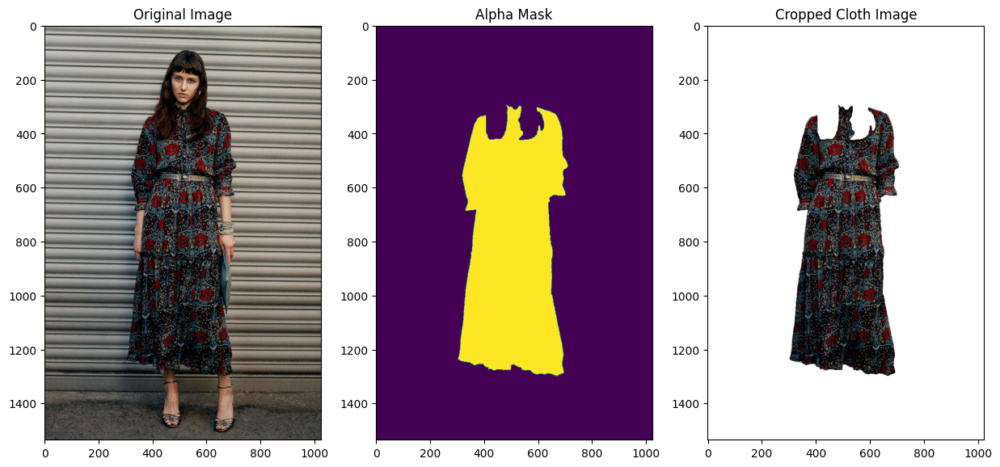

Processing image 27: https://cdn.privetouche.com/product/1024/1024/24S1R0004_113_24S_01_01.jpg
Transparent image saved to ./output/transparent_image_27.png
Saved image shape: (1536, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 

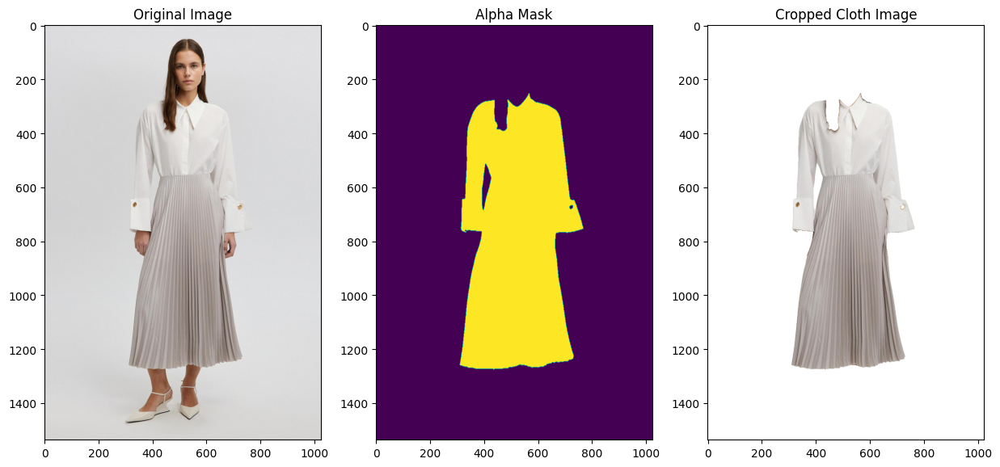

Processing image 28: https://cdn.privetouche.com/product/1024/1024/24S1S0006_195_24S_07_01.jpg
Transparent image saved to ./output/transparent_image_28.png
Saved image shape: (1535, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 

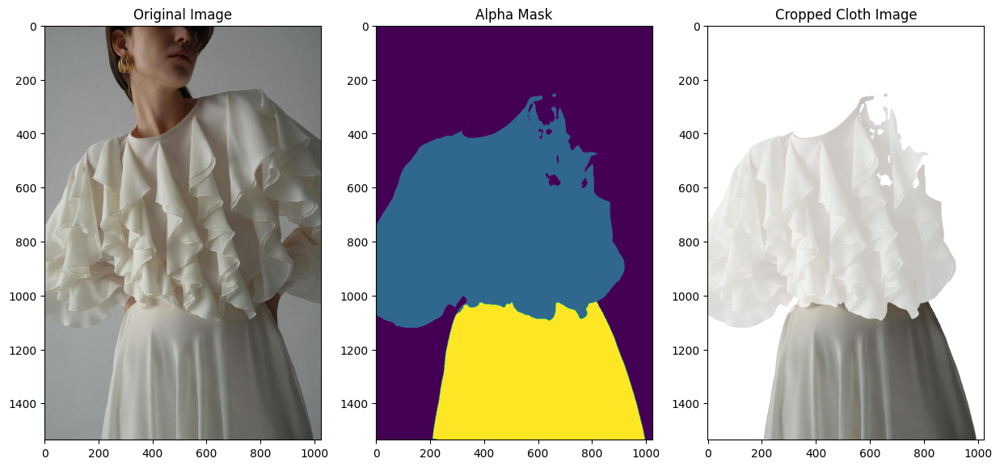

Processing image 29: https://cdn.privetouche.com/product/1024/1024/24S1S0007_195_24S_06_01.jpg
Transparent image saved to ./output/transparent_image_29.png
Saved image shape: (1535, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 

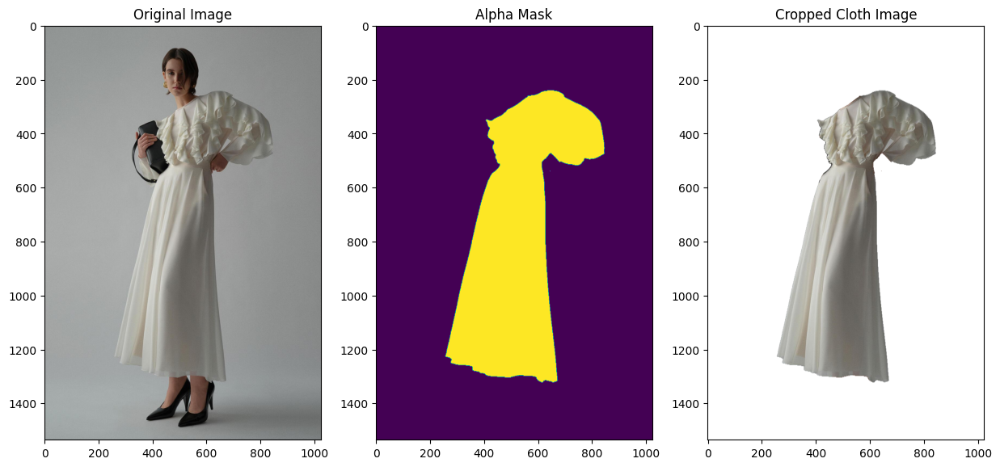

Processing image 30: https://cdn.privetouche.com/product/1024/1024/22S1T103_100_22S_08_01.jpg
Transparent image saved to ./output/transparent_image_30.png
Saved image shape: (1536, 1024, 4)
Unique values in saved image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 1

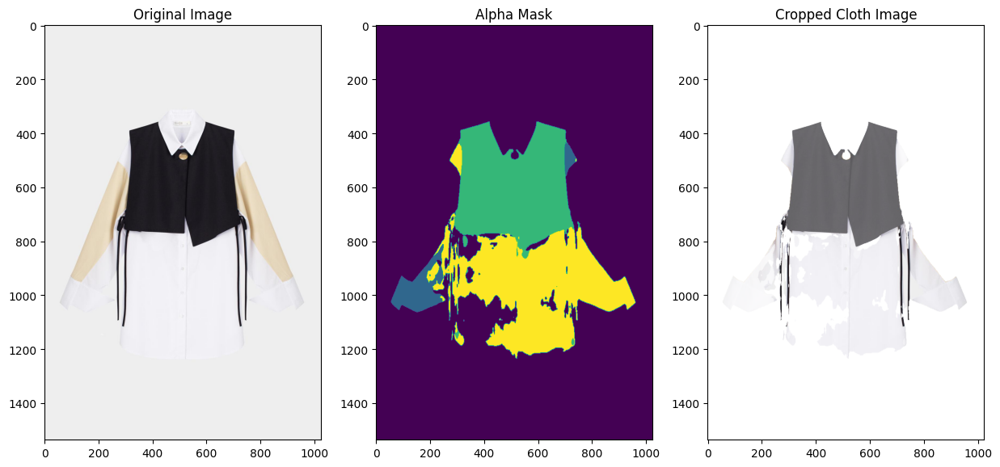

In [ ]:
import pandas as pd
import requests
import os
from PIL import Image
import cv2
import numpy as np



from matplotlib import pyplot as plt
import matplotlib.image as mpimg

import os
import numpy as np
from io import BytesIO
from PIL import Image
import torch
import torch.nn.functional as F
import torchvision.transforms as transforms
from collections import OrderedDict

# Import necessary functions from your existing script
from network import U2NET

def load_checkpoint(model, checkpoint_path):
    if not os.path.exists(checkpoint_path):
        print("----No checkpoints at given path----")
        return None
    model_state_dict = torch.load(checkpoint_path, map_location=torch.device("cpu"))
    new_state_dict = OrderedDict()
    for k, v in model_state_dict.items():
        name = k[7:]  # remove `module.`
        new_state_dict[name] = v

    model.load_state_dict(new_state_dict)
    print("----checkpoints loaded from path: {}----".format(checkpoint_path))
    return model

def get_palette(num_cls):
    n = num_cls
    palette = [0] * (n * 3)
    for j in range(0, n):
        lab = j
        palette[j * 3 + 0] = 0
        palette[j * 3 + 1] = 0
        palette[j * 3 + 2] = 0
        i = 0
        while lab:
            palette[j * 3 + 0] |= (((lab >> 0) & 1) << (7 - i))
            palette[j * 3 + 1] |= (((lab >> 1) & 1) << (7 - i))
            palette[j * 3 + 2] |= (((lab >> 2) & 1) << (7 - i))
            i += 1
            lab >>= 3
    return palette

class Normalize_image(object):
    def __init__(self, mean, std):
        assert isinstance(mean, float)
        assert isinstance(std, float)

        self.mean = mean
        self.std = std
        self.normalize_1 = transforms.Normalize(self.mean, self.std)
        self.normalize_3 = transforms.Normalize([self.mean] * 3, [self.std] * 3)
        self.normalize_18 = transforms.Normalize([self.mean] * 18, [self.std] * 18)

    def __call__(self, image_tensor):
        if image_tensor.shape[0] == 1:
            return self.normalize_1(image_tensor)
        elif image_tensor.shape[0] == 3:
            return self.normalize_3(image_tensor)
        elif image_tensor.shape[0] == 18:
            return self.normalize_18(image_tensor)
        else:
            raise ValueError("Normalization implemented only for 1, 3, and 18 channel tensors")

def apply_transform(img):
    transforms_list = [transforms.ToTensor(), Normalize_image(0.5, 0.5)]
    transform_rgb = transforms.Compose(transforms_list)
    return transform_rgb(img)

def generate_mask(input_image, net, palette, device='cpu'):
    img = input_image
    img_size = img.size
    img = img.resize((768, 768), Image.BICUBIC)
    image_tensor = apply_transform(img)
    image_tensor = torch.unsqueeze(image_tensor, 0)

    alpha_out_dir = os.path.join('./output/alpha')
    cloth_seg_out_dir = os.path.join('./output/cloth_seg')

    os.makedirs(alpha_out_dir, exist_ok=True)
    os.makedirs(cloth_seg_out_dir, exist_ok=True)

    with torch.no_grad():
        output_tensor = net(image_tensor.to(device))
        output_tensor = F.log_softmax(output_tensor[0], dim=1)
        output_tensor = torch.max(output_tensor, dim=1, keepdim=True)[1]
        output_tensor = torch.squeeze(output_tensor, dim=0)
        output_arr = output_tensor.cpu().numpy()

    # Ensure output_arr is 2D
    if output_arr.ndim == 3:
        output_arr = output_arr[0]  # Remove the single channel dimension
    elif output_arr.ndim > 2:
        output_arr = output_arr.squeeze()

    if output_arr.ndim != 2:
        raise ValueError(f"Expected 2D array for image, but got {output_arr.ndim}D array")

    cloth_seg = Image.fromarray(output_arr.astype(np.uint8), mode='P')
    cloth_seg.putpalette(palette)
    cloth_seg = cloth_seg.resize(img_size, Image.BICUBIC)
    cloth_seg.save(os.path.join(cloth_seg_out_dir, 'final_seg.png'))

    alpha_mask = Image.fromarray(output_arr.astype(np.uint8), mode='L')
    alpha_mask = alpha_mask.resize(img_size, Image.BICUBIC)
    alpha_mask.save(os.path.join(alpha_out_dir, '1.png'))

    return cloth_seg

def save_transparent_image(image_path, alpha_path, output_path):
    original_image = cv2.imread(image_path)
    if original_image is None:
        raise FileNotFoundError(f"Original image not found at {image_path}")

    alpha_mask = cv2.imread(alpha_path, cv2.IMREAD_GRAYSCALE)
    if alpha_mask is None:
        raise FileNotFoundError(f"Alpha mask not found or cannot be read from {alpha_path}")

    if np.all(alpha_mask == 0):
        raise ValueError(f"Alpha mask is empty or contains only zeros.")

    alpha_mask = cv2.resize(alpha_mask, (original_image.shape[1], original_image.shape[0]))
    alpha_mask = cv2.normalize(alpha_mask, None, 0, 255, cv2.NORM_MINMAX)

    b, g, r = cv2.split(original_image)
    rgba_image = cv2.merge([b, g, r, alpha_mask])

    cv2.imwrite(output_path, rgba_image)
    print(f"Transparent image saved to {output_path}")

    saved_image = cv2.imread(output_path, cv2.IMREAD_UNCHANGED)
    if saved_image is None:
        raise ValueError(f"Failed to load saved transparent image from {output_path}")
    #print(f"Saved image shape: {saved_image.shape}")


def load_seg_model(checkpoint_path, device='cpu'):
    net = U2NET(in_ch=3, out_ch=4)
    net = load_checkpoint(net, checkpoint_path)
    if net is None:
        return None
    net = net.to(device)
    net = net.eval()
    return net

def image_view(image, mask, result):
    img = mpimg.imread(image)
    masked = mpimg.imread(mask)
    transparent = mpimg.imread(result)

    fig = plt.figure(figsize=(15, 10))
    ax = fig.add_subplot(1, 3, 1)
    ax.imshow(img)
    ax.set_title('Original Image')
    ax1 = fig.add_subplot(1, 3, 2)
    ax1.imshow(masked)
    ax1.set_title('Alpha Mask')
    ax2 = fig.add_subplot(1, 3, 3)
    ax2.imshow(transparent)
    ax2.set_title('Cropped Cloth Image')
    plt.show()

def download_image(url, save_dir):
    try:
        response = requests.get(url)
        response.raise_for_status()
        img = Image.open(BytesIO(response.content)).convert('RGB')
        img_name = os.path.basename(url)
        img_path = os.path.join(save_dir, img_name)
        img.save(img_path)
        return img_path
    except requests.exceptions.RequestException as e:
        print(f"Error downloading image from {url}: {e}")
        return None

def main_from_csv(csv_file_path, save_dir, cuda=False, checkpoint_path='/content/cloth_segm.pth', num_images=30):
    df = pd.read_csv(csv_file_path)
    if 'SecenekResim1' not in df.columns:
        raise ValueError("CSV dosyasının 'SecenekResim1' sütunu içermesi gerekiyor.")

    urls = df['SecenekResim1'].head(num_images)

    device = 'cuda:0' if cuda else 'cpu'
    model = load_seg_model(checkpoint_path, device=device)
    if model is None:
        return

    palette = get_palette(4)

    for index, url in enumerate(urls):
        print(f"Processing image {index + 1}: {url}")
        img_path = download_image(url, save_dir)
        if img_path is None:
            continue

        img = Image.open(img_path).convert('RGB')
        generate_mask(img, model, palette)

        alpha_out = './output/alpha/1.png'
        output_path = f'./output/transparent_image_{index + 1}.png'
        save_transparent_image(img_path, alpha_out, output_path)
        image_view(img_path, alpha_out, output_path)

csv_file_path = '/content/data.csv'
save_dir = './downloaded_images'

os.makedirs(save_dir, exist_ok=True)
os.makedirs('output/alpha', exist_ok=True)
os.makedirs('output/cloth_seg', exist_ok=True)

main_from_csv(csv_file_path, save_dir, num_images=30)


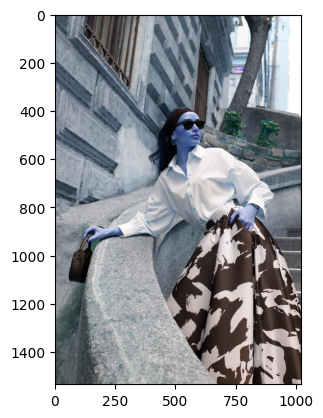

In [ ]:

from PIL import Image
import matplotlib.pyplot as plt
import torch
import cv2

img = cv2.imread("/content/resim.jpg", cv2.IMREAD_COLOR)
plt.imshow(img); plt.show()

# Define the helper function
def decode_segmap(image, nc=21):

  label_colors = np.array([(0, 0, 0),  # 0=background
               # 1=aeroplane, 2=bicycle, 3=bird, 4=boat, 5=bottle
               (128, 0, 0), (0, 128, 0), (255, 255, 255), (0, 0, 128), (128, 0, 128),
               # 6=bus, 7=car, 8=cat, 9=chair, 10=cow
               (0, 128, 128), (128, 128, 128), (64, 0, 0), (192, 0, 0), (64, 128, 0),
               # 11=dining table, 12=dog, 13=horse, 14=motorbike, 15=person
               (192, 128, 0), (64, 0, 128), (192, 0, 128), (64, 128, 128), (255, 255, 255),
               # 16=potted plant, 17=sheep, 18=sofa, 19=train, 20=tv/monitor
               (0, 64, 0), (128, 64, 0), (0, 192, 0), (128, 192, 0), (0, 64, 128)])

  r = np.zeros_like(image).astype(np.uint8)
  g = np.zeros_like(image).astype(np.uint8)
  b = np.zeros_like(image).astype(np.uint8)

  for l in range(0, nc):
    idx = image == l
    r[idx] = label_colors[l, 0]
    g[idx] = label_colors[l, 1]
    b[idx] = label_colors[l, 2]

  rgb = np.stack([r, g, b], axis=2)
  return rgb


from google.colab import files
import torchvision.transforms as T
import numpy as np

def segment(net, path, show_orig=True, dev='cuda'):
  img = Image.open(path)
  if show_orig: plt.imshow(img); plt.axis('off'); plt.show()
  # Comment the Resize and CenterCrop for better inference results
  trf = T.Compose([#T.Resize(640),
                   #T.CenterCrop(224),
                   T.ToTensor(),
                   T.Normalize(mean = [0.485, 0.456, 0.406],
                               std = [0.229, 0.224, 0.225])])
  inp = trf(img).unsqueeze(0).to(dev)
  out = net.to(dev)(inp)['out']
  om = torch.argmax(out.squeeze(), dim=0).detach().cpu().numpy()
  rgb = decode_segmap(om)
  plt.imshow(rgb); plt.axis('off'); plt.show()
  cv2.imwrite('mask2.png' , rgb)
  files.download('mask2.png')
  return rgb



In [ ]:

from torchvision import models

dlab = models.segmentation.deeplabv3_resnet101(pretrained=1).eval()

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DeepLabV3_ResNet101_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=DeepLabV3_ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


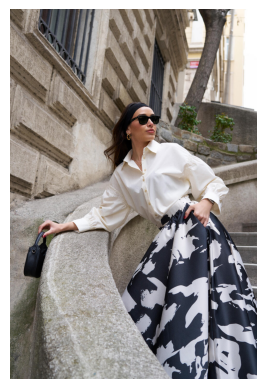

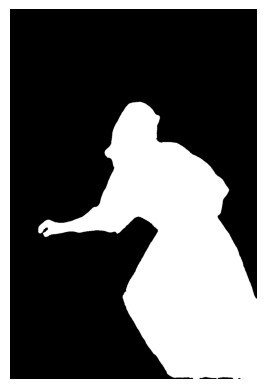

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
rgb=segment(dlab, '/content/resim.jpg')

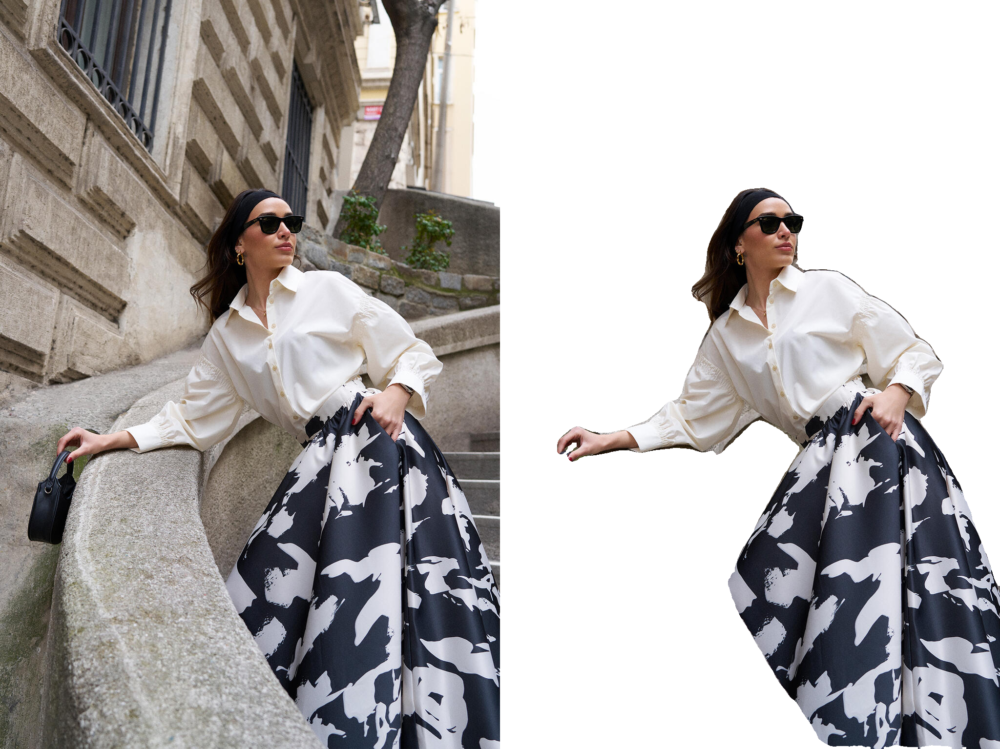

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:


#whiten the background of the image
import cv2
from google.colab.patches import cv2_imshow

mask_out=cv2.subtract(rgb,img)
mask_out=cv2.subtract(rgb,mask_out)
mask_out[rgb == 0] = 255
#plt.imshow(mask_out); plt.show()
cv2.imwrite('out4.jpeg' , mask_out)
numpy_horizontal = np.hstack((img, mask_out))

numpy_horizontal_concat = np.concatenate((img, mask_out), axis=1)
# Display image
cv2_imshow(numpy_horizontal_concat)
cv2.waitKey(0)
# Display image
cv2.imwrite('res.png' , numpy_horizontal_concat)
